In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 757.2/757.2 kB 9.0 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-many

In [ ]:
# Mount Google Drive b
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from ultralytics import YOLO
model = YOLO("yolo-Weights/yolov8n.pt")

100%|██████████| 6.23M/6.23M [00:00<00:00, 21.2MB/s]


In [ ]:
from ultralytics import YOLO
import cv2
import math
from google.colab.patches import cv2_imshow

In [ ]:
# Path to the uploaded video file
video_path = "video.mp4"


# rtsp_url = 'rtsp://ip.port/h264_ulaw.sdp'
# cap = cv2.VideoCapture(rtsp_url)


# cap = cv2.VideoCapture('https://www.skylinewebcams.com/en/webcam/italia/veneto/venezia/rialto-canal-grande.html')
# Open the video file
cap = cv2.VideoCapture(video_path)

# Get video properties
fps = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
frame_size = (width, height)

# Output video file
output_path = "output_video.mp4"
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Codec
out = cv2.VideoWriter(output_path, fourcc, fps, frame_size)

# Model
model = YOLO("yolo-Weights/yolov8n.pt")

# Object classes
classNames = ["person", "bicycle", "car", "motorbike", "aeroplane", "bus", "train", "truck", "boat",
              "traffic light", "fire hydrant", "stop sign", "parking meter", "bench", "bird", "cat",
              "dog", "horse", "sheep", "cow", "elephant", "bear", "zebra", "giraffe", "backpack", "umbrella",
              "handbag", "tie", "suitcase", "frisbee", "skis", "snowboard", "sports ball", "kite", "baseball bat",
              "baseball glove", "skateboard", "surfboard", "tennis racket", "bottle", "wine glass", "cup",
              "fork", "knife", "spoon", "bowl", "banana", "apple", "sandwich", "orange", "broccoli",
              "carrot", "hot dog", "pizza", "donut", "cake", "chair", "sofa", "pottedplant", "bed",
              "diningtable", "toilet", "tvmonitor", "laptop", "mouse", "remote", "keyboard", "cell phone",
              "microwave", "oven", "toaster", "sink", "refrigerator", "book", "clock", "vase", "scissors",
              "teddy bear", "hair drier", "toothbrush"
              ]

while cap.isOpened():
    success, img = cap.read()

    if success:
        results = model(img, stream=True)

        # Coordinates
        for r in results:
            boxes = r.boxes

            for box in boxes:
                # Bounding box
                x1, y1, x2, y2 = box.xyxy[0]
                x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)  # Convert to int values

                # Put box in cam
                cv2.rectangle(img, (x1, y1), (x2, y2), (255, 0, 255), 3)

                # Confidence
                confidence = math.ceil((box.conf[0] * 100)) / 100
                print("Confidence --->", confidence)

                # Class name
                cls = int(box.cls[0])
                print("Class name -->", classNames[cls])

                # Object details
                org = (x1, y1)
                font = cv2.FONT_HERSHEY_SIMPLEX
                fontScale = 1
                color = (255, 0, 0)
                thickness = 2

                cv2.putText(img, classNames[cls], org, font, fontScale, color, thickness)

        # Show the frame (optional, comment out if not needed)
        # cv2_imshow(img)

        # Write the frame to the output video
        out.write(img)
    else:
        break

# Release resources
cap.release()
out.release()
cv2.destroyAllWindows()

# Download the video
from google.colab import files
files.download(output_path)

Streaming output truncated to the last 5000 lines.
Confidence ---> 0.5
Class name --> person
Confidence ---> 0.47
Class name --> person
Confidence ---> 0.43
Class name --> person
Confidence ---> 0.42
Class name --> person
Confidence ---> 0.41
Class name --> person
Confidence ---> 0.39
Class name --> person
Confidence ---> 0.39
Class name --> person
Confidence ---> 0.39
Class name --> person
Confidence ---> 0.38
Class name --> bird
Confidence ---> 0.33
Class name --> person
Confidence ---> 0.32
Class name --> person
Confidence ---> 0.32
Class name --> bird
Confidence ---> 0.32
Class name --> bird
Confidence ---> 0.28
Class name --> person
Confidence ---> 0.27
Class name --> person
Speed: 5.4ms preprocess, 176.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 29 persons, 4 birds, 182.0ms
Confidence ---> 0.83
Class name --> person
Confidence ---> 0.78
Class name --> person
Confidence ---> 0.77
Class name --> person
Confidence ---> 0.75
Class name --> person


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
!pip install pytube

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.6/57.6 kB 1.9 MB/s eta 0:00:00



0: 384x640 14 persons, 1 bicycle, 3 cars, 1 traffic light, 3 backpacks, 288.5ms
Confidence ---> 0.89
Class name --> person
Confidence ---> 0.86
Class name --> bicycle
Confidence ---> 0.83
Class name --> person
Confidence ---> 0.83
Class name --> person
Confidence ---> 0.79
Class name --> person
Confidence ---> 0.79
Class name --> car
Confidence ---> 0.74
Class name --> person
Confidence ---> 0.69
Class name --> person
Confidence ---> 0.62
Class name --> car
Confidence ---> 0.45
Class name --> backpack
Confidence ---> 0.44
Class name --> person
Confidence ---> 0.44
Class name --> person
Confidence ---> 0.43
Class name --> traffic light
Confidence ---> 0.4
Class name --> person
Confidence ---> 0.4
Class name --> car
Confidence ---> 0.35
Class name --> person
Confidence ---> 0.35
Class name --> person
Confidence ---> 0.35
Class name --> person
Confidence ---> 0.33
Class name --> person
Confidence ---> 0.29
Class name --> backpack
Confidence ---> 0.28
Class name --> person
Confidence --->

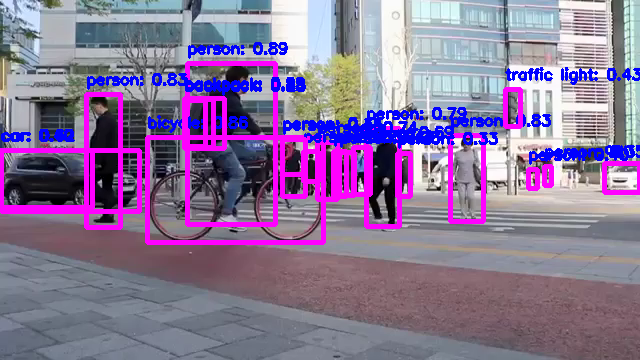


0: 384x640 5 persons, 1 bicycle, 3 cars, 1 traffic light, 1 backpack, 150.3ms
Confidence ---> 0.86
Class name --> bicycle
Confidence ---> 0.85
Class name --> car
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.81
Class name --> person
Confidence ---> 0.77
Class name --> car
Confidence ---> 0.66
Class name --> backpack
Confidence ---> 0.56
Class name --> person
Confidence ---> 0.35
Class name --> traffic light
Confidence ---> 0.31
Class name --> person
Confidence ---> 0.29
Class name --> person
Confidence ---> 0.28
Class name --> car
Speed: 4.8ms preprocess, 150.3ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


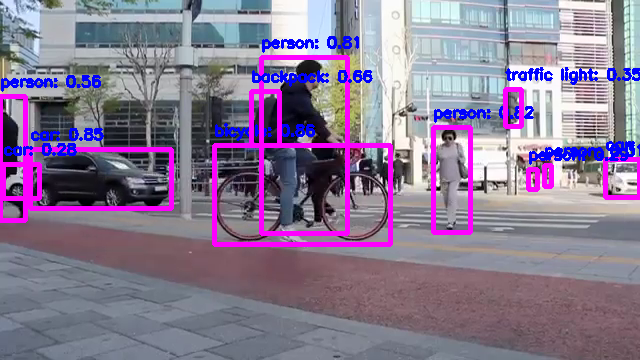


0: 384x640 4 persons, 1 bicycle, 2 cars, 1 traffic light, 1 backpack, 205.0ms
Confidence ---> 0.9
Class name --> bicycle
Confidence ---> 0.87
Class name --> person
Confidence ---> 0.87
Class name --> car
Confidence ---> 0.78
Class name --> car
Confidence ---> 0.77
Class name --> person
Confidence ---> 0.64
Class name --> backpack
Confidence ---> 0.37
Class name --> traffic light
Confidence ---> 0.28
Class name --> person
Confidence ---> 0.26
Class name --> person
Speed: 4.1ms preprocess, 205.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


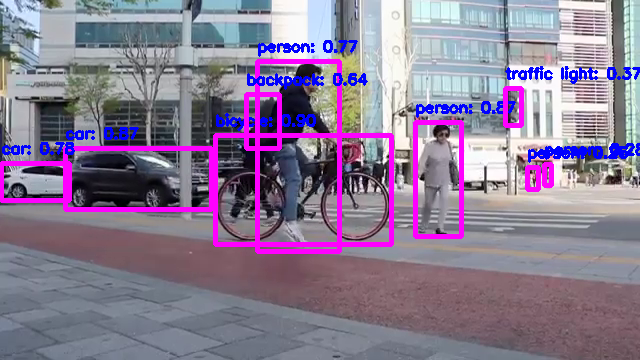


0: 384x640 4 persons, 1 bicycle, 5 cars, 1 skateboard, 230.7ms
Confidence ---> 0.93
Class name --> bicycle
Confidence ---> 0.89
Class name --> car
Confidence ---> 0.89
Class name --> car
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.77
Class name --> person
Confidence ---> 0.77
Class name --> person
Confidence ---> 0.76
Class name --> car
Confidence ---> 0.51
Class name --> car
Confidence ---> 0.48
Class name --> skateboard
Confidence ---> 0.34
Class name --> car
Confidence ---> 0.32
Class name --> person
Speed: 4.7ms preprocess, 230.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


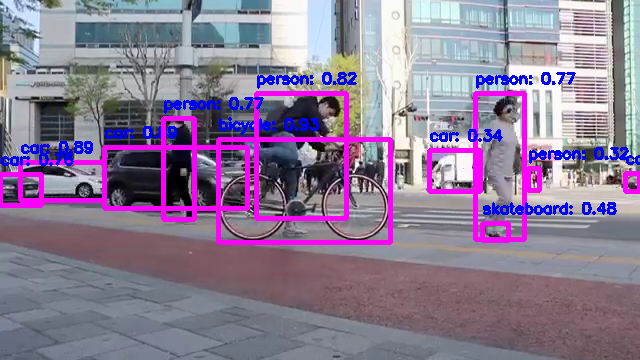


0: 384x640 6 persons, 1 bicycle, 3 cars, 1 truck, 1 traffic light, 229.5ms
Confidence ---> 0.92
Class name --> bicycle
Confidence ---> 0.86
Class name --> car
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.79
Class name --> car
Confidence ---> 0.73
Class name --> person
Confidence ---> 0.72
Class name --> car
Confidence ---> 0.61
Class name --> person
Confidence ---> 0.5
Class name --> truck
Confidence ---> 0.39
Class name --> traffic light
Confidence ---> 0.32
Class name --> person
Confidence ---> 0.31
Class name --> person
Confidence ---> 0.29
Class name --> person
Speed: 3.5ms preprocess, 229.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


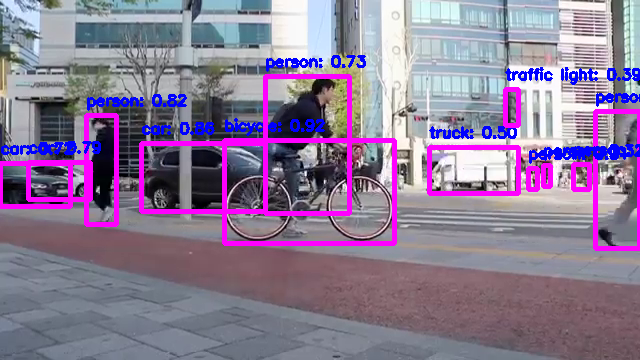


0: 384x640 3 persons, 1 bicycle, 5 cars, 1 truck, 1 traffic light, 2 backpacks, 219.5ms
Confidence ---> 0.83
Class name --> bicycle
Confidence ---> 0.8
Class name --> person
Confidence ---> 0.69
Class name --> person
Confidence ---> 0.69
Class name --> car
Confidence ---> 0.43
Class name --> car
Confidence ---> 0.42
Class name --> truck
Confidence ---> 0.41
Class name --> traffic light
Confidence ---> 0.38
Class name --> person
Confidence ---> 0.37
Class name --> car
Confidence ---> 0.37
Class name --> backpack
Confidence ---> 0.36
Class name --> backpack
Confidence ---> 0.32
Class name --> car
Confidence ---> 0.31
Class name --> car
Speed: 3.3ms preprocess, 219.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


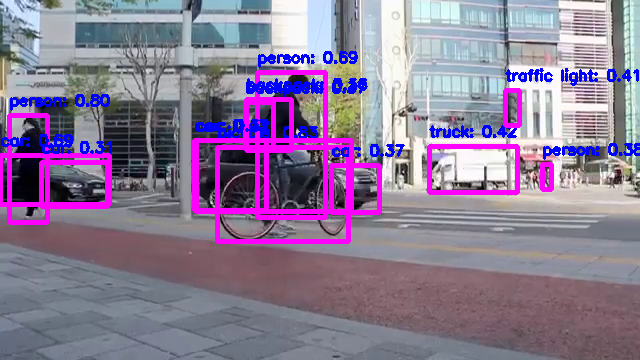


0: 384x640 2 persons, 1 bicycle, 3 cars, 1 traffic light, 1 backpack, 226.8ms
Confidence ---> 0.86
Class name --> bicycle
Confidence ---> 0.83
Class name --> car
Confidence ---> 0.75
Class name --> car
Confidence ---> 0.74
Class name --> person
Confidence ---> 0.55
Class name --> car
Confidence ---> 0.34
Class name --> backpack
Confidence ---> 0.32
Class name --> traffic light
Confidence ---> 0.32
Class name --> person
Speed: 3.4ms preprocess, 226.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


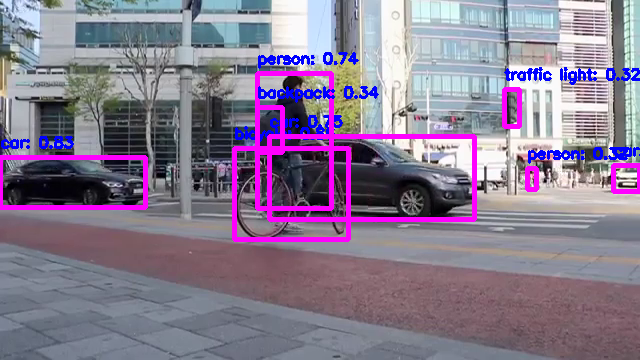


0: 384x640 2 persons, 1 bicycle, 5 cars, 244.0ms
Confidence ---> 0.93
Class name --> car
Confidence ---> 0.81
Class name --> bicycle
Confidence ---> 0.81
Class name --> car
Confidence ---> 0.79
Class name --> car
Confidence ---> 0.72
Class name --> person
Confidence ---> 0.6
Class name --> car
Confidence ---> 0.52
Class name --> person
Confidence ---> 0.3
Class name --> car
Speed: 3.3ms preprocess, 244.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


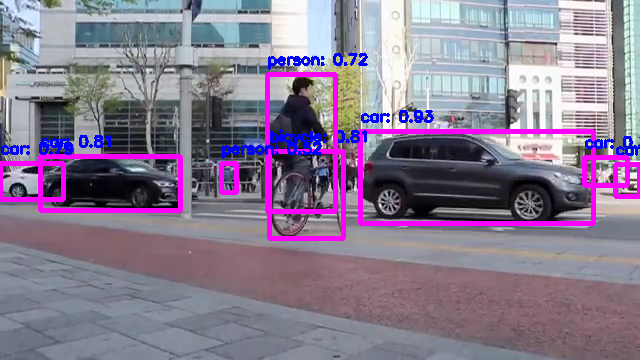


0: 384x640 2 persons, 2 bicycles, 4 cars, 1 backpack, 213.2ms
Confidence ---> 0.92
Class name --> car
Confidence ---> 0.9
Class name --> car
Confidence ---> 0.88
Class name --> car
Confidence ---> 0.87
Class name --> bicycle
Confidence ---> 0.61
Class name --> car
Confidence ---> 0.6
Class name --> person
Confidence ---> 0.33
Class name --> person
Confidence ---> 0.27
Class name --> bicycle
Confidence ---> 0.27
Class name --> backpack
Speed: 3.4ms preprocess, 213.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


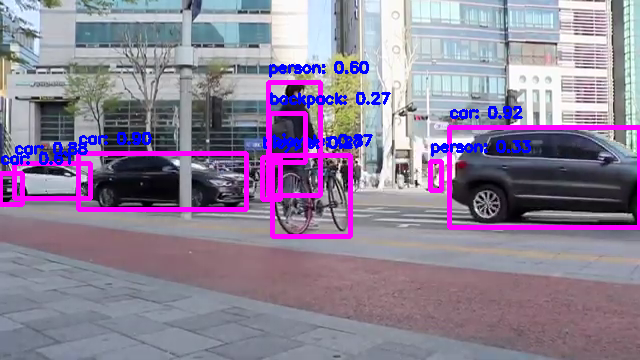


0: 384x640 1 person, 1 bicycle, 4 cars, 1 backpack, 268.4ms
Confidence ---> 0.9
Class name --> car
Confidence ---> 0.9
Class name --> car
Confidence ---> 0.9
Class name --> bicycle
Confidence ---> 0.86
Class name --> car
Confidence ---> 0.81
Class name --> car
Confidence ---> 0.77
Class name --> person
Confidence ---> 0.39
Class name --> backpack
Speed: 7.6ms preprocess, 268.4ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


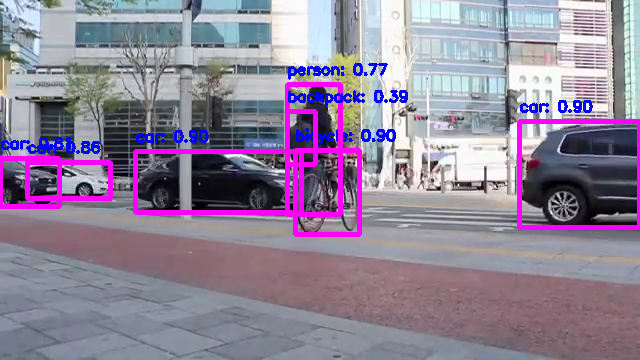


0: 384x640 2 persons, 1 bicycle, 4 cars, 1 traffic light, 294.9ms
Confidence ---> 0.83
Class name --> car
Confidence ---> 0.8
Class name --> person
Confidence ---> 0.77
Class name --> car
Confidence ---> 0.66
Class name --> car
Confidence ---> 0.65
Class name --> bicycle
Confidence ---> 0.6
Class name --> person
Confidence ---> 0.4
Class name --> car
Confidence ---> 0.37
Class name --> traffic light
Speed: 5.5ms preprocess, 294.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


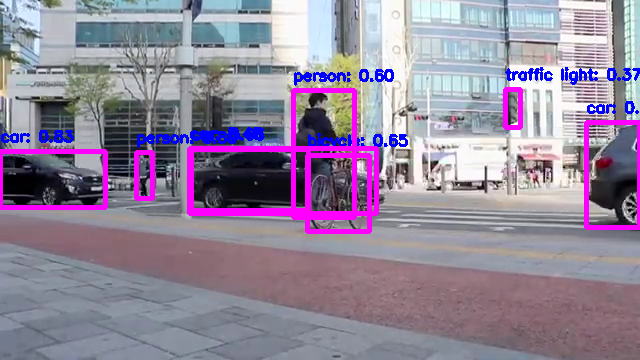


0: 384x640 1 person, 1 bicycle, 3 cars, 247.3ms
Confidence ---> 0.9
Class name --> car
Confidence ---> 0.8
Class name --> bicycle
Confidence ---> 0.71
Class name --> car
Confidence ---> 0.6
Class name --> car
Confidence ---> 0.52
Class name --> person
Speed: 5.0ms preprocess, 247.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


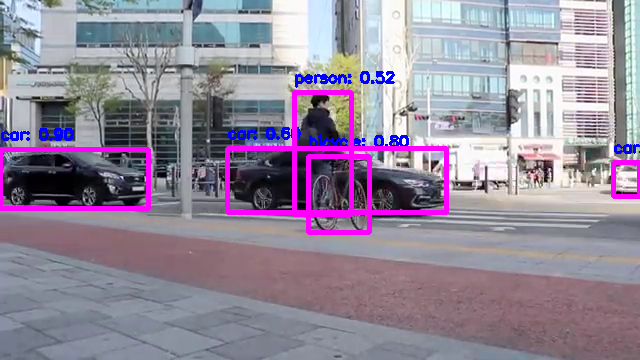


0: 384x640 7 persons, 1 bicycle, 3 cars, 314.5ms
Confidence ---> 0.84
Class name --> bicycle
Confidence ---> 0.78
Class name --> car
Confidence ---> 0.77
Class name --> person
Confidence ---> 0.77
Class name --> car
Confidence ---> 0.46
Class name --> car
Confidence ---> 0.4
Class name --> person
Confidence ---> 0.34
Class name --> person
Confidence ---> 0.32
Class name --> person
Confidence ---> 0.29
Class name --> person
Confidence ---> 0.28
Class name --> person
Confidence ---> 0.26
Class name --> person
Speed: 3.6ms preprocess, 314.5ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


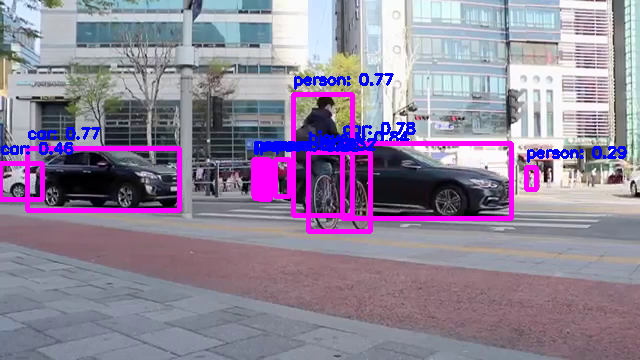


0: 384x640 3 persons, 1 bicycle, 6 cars, 273.2ms
Confidence ---> 0.89
Class name --> car
Confidence ---> 0.84
Class name --> bicycle
Confidence ---> 0.84
Class name --> car
Confidence ---> 0.81
Class name --> person
Confidence ---> 0.78
Class name --> car
Confidence ---> 0.75
Class name --> car
Confidence ---> 0.61
Class name --> person
Confidence ---> 0.3
Class name --> person
Confidence ---> 0.28
Class name --> car
Confidence ---> 0.27
Class name --> car
Speed: 3.4ms preprocess, 273.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


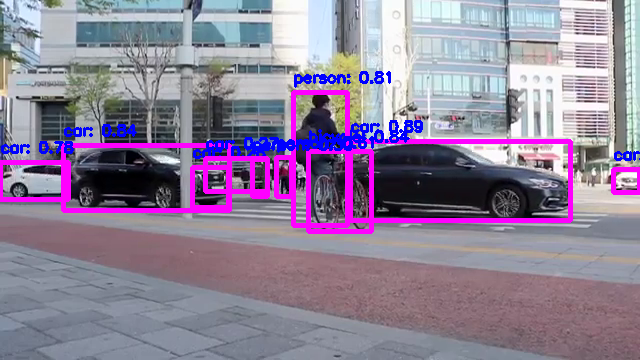


0: 384x640 7 persons, 1 bicycle, 3 cars, 221.9ms
Confidence ---> 0.94
Class name --> car
Confidence ---> 0.88
Class name --> car
Confidence ---> 0.86
Class name --> bicycle
Confidence ---> 0.79
Class name --> person
Confidence ---> 0.5
Class name --> car
Confidence ---> 0.42
Class name --> person
Confidence ---> 0.4
Class name --> person
Confidence ---> 0.38
Class name --> person
Confidence ---> 0.37
Class name --> person
Confidence ---> 0.37
Class name --> person
Confidence ---> 0.34
Class name --> person
Speed: 3.2ms preprocess, 221.9ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


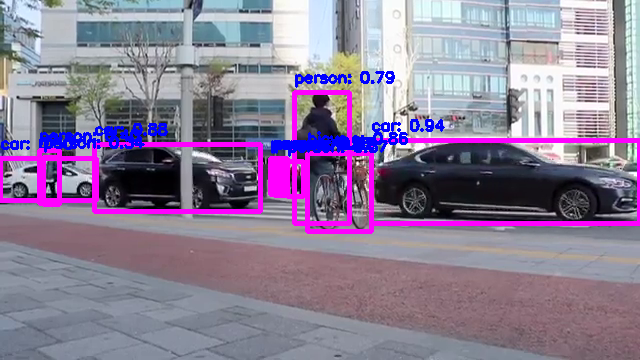


0: 384x640 2 persons, 3 bicycles, 3 cars, 202.3ms
Confidence ---> 0.92
Class name --> car
Confidence ---> 0.9
Class name --> car
Confidence ---> 0.85
Class name --> person
Confidence ---> 0.83
Class name --> bicycle
Confidence ---> 0.74
Class name --> person
Confidence ---> 0.71
Class name --> car
Confidence ---> 0.42
Class name --> bicycle
Confidence ---> 0.27
Class name --> bicycle
Speed: 1.8ms preprocess, 202.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


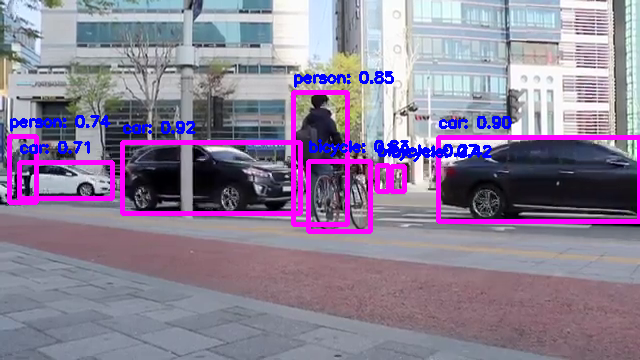


0: 384x640 4 persons, 1 bicycle, 4 cars, 1 truck, 209.7ms
Confidence ---> 0.93
Class name --> car
Confidence ---> 0.88
Class name --> bicycle
Confidence ---> 0.88
Class name --> car
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.75
Class name --> person
Confidence ---> 0.71
Class name --> person
Confidence ---> 0.64
Class name --> person
Confidence ---> 0.59
Class name --> car
Confidence ---> 0.35
Class name --> car
Confidence ---> 0.29
Class name --> truck
Speed: 3.3ms preprocess, 209.7ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


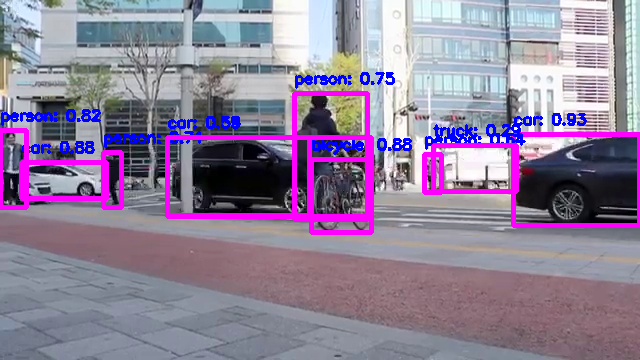


0: 384x640 4 persons, 1 bicycle, 4 cars, 1 traffic light, 220.9ms
Confidence ---> 0.86
Class name --> bicycle
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.77
Class name --> person
Confidence ---> 0.74
Class name --> person
Confidence ---> 0.71
Class name --> car
Confidence ---> 0.61
Class name --> car
Confidence ---> 0.5
Class name --> traffic light
Confidence ---> 0.38
Class name --> car
Confidence ---> 0.37
Class name --> car
Confidence ---> 0.26
Class name --> person
Speed: 3.5ms preprocess, 220.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


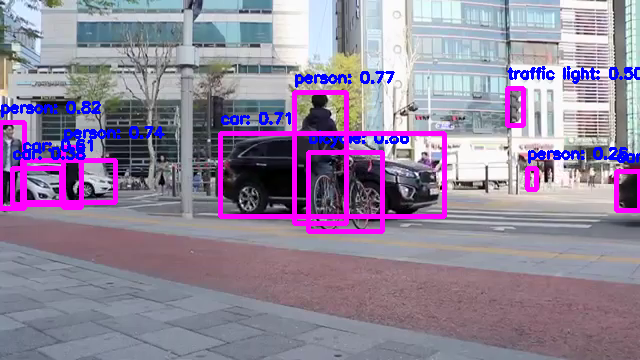


0: 384x640 7 persons, 1 bicycle, 3 cars, 1 traffic light, 205.2ms
Confidence ---> 0.86
Class name --> bicycle
Confidence ---> 0.79
Class name --> person
Confidence ---> 0.72
Class name --> person
Confidence ---> 0.65
Class name --> person
Confidence ---> 0.63
Class name --> person
Confidence ---> 0.63
Class name --> car
Confidence ---> 0.61
Class name --> car
Confidence ---> 0.49
Class name --> person
Confidence ---> 0.39
Class name --> traffic light
Confidence ---> 0.27
Class name --> person
Confidence ---> 0.26
Class name --> car
Confidence ---> 0.26
Class name --> person
Speed: 3.0ms preprocess, 205.2ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


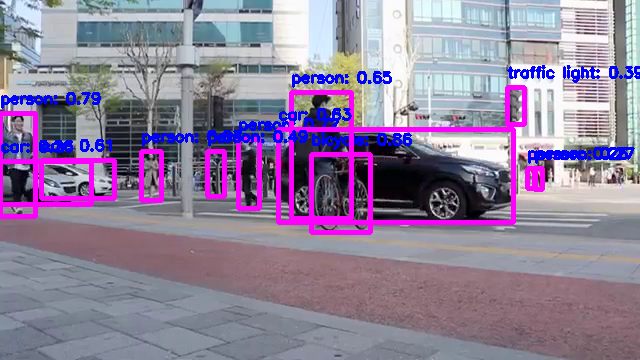


0: 384x640 5 persons, 1 bicycle, 3 cars, 1 traffic light, 1 backpack, 213.0ms
Confidence ---> 0.85
Class name --> person
Confidence ---> 0.84
Class name --> car
Confidence ---> 0.8
Class name --> bicycle
Confidence ---> 0.8
Class name --> person
Confidence ---> 0.58
Class name --> car
Confidence ---> 0.38
Class name --> person
Confidence ---> 0.34
Class name --> person
Confidence ---> 0.32
Class name --> car
Confidence ---> 0.29
Class name --> traffic light
Confidence ---> 0.27
Class name --> backpack
Confidence ---> 0.27
Class name --> person
Speed: 3.7ms preprocess, 213.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


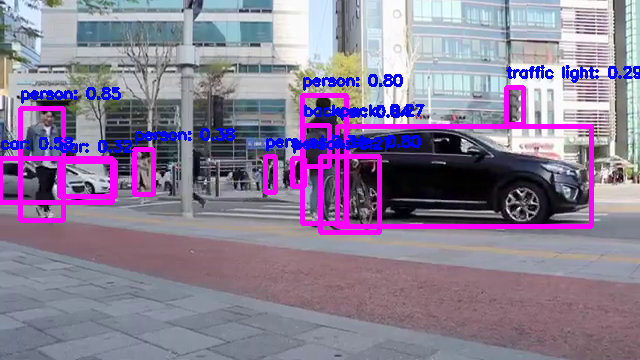


0: 384x640 10 persons, 1 bicycle, 2 cars, 239.7ms
Confidence ---> 0.91
Class name --> car
Confidence ---> 0.89
Class name --> car
Confidence ---> 0.84
Class name --> person
Confidence ---> 0.84
Class name --> person
Confidence ---> 0.7
Class name --> person
Confidence ---> 0.69
Class name --> bicycle
Confidence ---> 0.67
Class name --> person
Confidence ---> 0.51
Class name --> person
Confidence ---> 0.32
Class name --> person
Confidence ---> 0.3
Class name --> person
Confidence ---> 0.29
Class name --> person
Confidence ---> 0.26
Class name --> person
Confidence ---> 0.26
Class name --> person
Speed: 3.4ms preprocess, 239.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


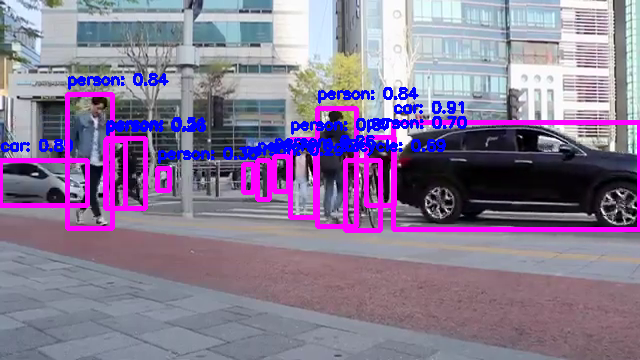


0: 384x640 8 persons, 1 bicycle, 2 cars, 2 skateboards, 233.2ms
Confidence ---> 0.9
Class name --> car
Confidence ---> 0.85
Class name --> person
Confidence ---> 0.77
Class name --> car
Confidence ---> 0.77
Class name --> bicycle
Confidence ---> 0.76
Class name --> person
Confidence ---> 0.72
Class name --> person
Confidence ---> 0.71
Class name --> person
Confidence ---> 0.69
Class name --> person
Confidence ---> 0.51
Class name --> person
Confidence ---> 0.4
Class name --> person
Confidence ---> 0.31
Class name --> skateboard
Confidence ---> 0.3
Class name --> skateboard
Confidence ---> 0.28
Class name --> person
Speed: 1.7ms preprocess, 233.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


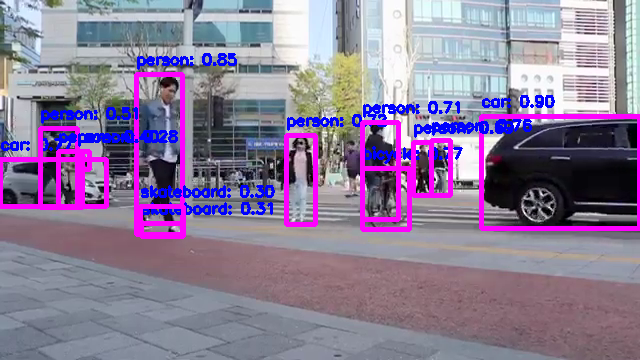


0: 384x640 14 persons, 1 bicycle, 2 cars, 1 traffic light, 1 backpack, 2 skateboards, 238.5ms
Confidence ---> 0.83
Class name --> person
Confidence ---> 0.81
Class name --> person
Confidence ---> 0.77
Class name --> person
Confidence ---> 0.66
Class name --> car
Confidence ---> 0.63
Class name --> bicycle
Confidence ---> 0.49
Class name --> person
Confidence ---> 0.46
Class name --> skateboard
Confidence ---> 0.46
Class name --> person
Confidence ---> 0.44
Class name --> person
Confidence ---> 0.42
Class name --> person
Confidence ---> 0.39
Class name --> car
Confidence ---> 0.39
Class name --> person
Confidence ---> 0.38
Class name --> person
Confidence ---> 0.38
Class name --> person
Confidence ---> 0.37
Class name --> traffic light
Confidence ---> 0.35
Class name --> person
Confidence ---> 0.33
Class name --> person
Confidence ---> 0.33
Class name --> skateboard
Confidence ---> 0.28
Class name --> person
Confidence ---> 0.28
Class name --> person
Confidence ---> 0.27
Class name -->

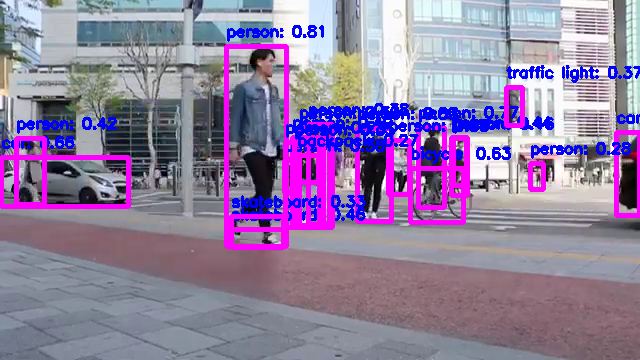


0: 384x640 6 persons, 2 bicycles, 3 cars, 1 traffic light, 1 backpack, 234.8ms
Confidence ---> 0.84
Class name --> person
Confidence ---> 0.84
Class name --> bicycle
Confidence ---> 0.8
Class name --> person
Confidence ---> 0.76
Class name --> car
Confidence ---> 0.74
Class name --> person
Confidence ---> 0.72
Class name --> person
Confidence ---> 0.56
Class name --> person
Confidence ---> 0.46
Class name --> bicycle
Confidence ---> 0.41
Class name --> traffic light
Confidence ---> 0.32
Class name --> car
Confidence ---> 0.29
Class name --> backpack
Confidence ---> 0.29
Class name --> car
Confidence ---> 0.26
Class name --> person
Speed: 9.7ms preprocess, 234.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


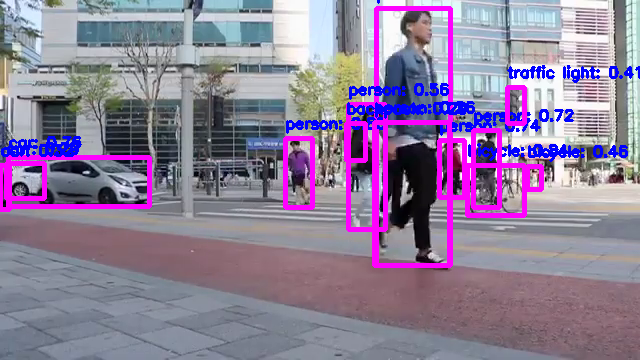


0: 384x640 9 persons, 2 bicycles, 4 cars, 1 skateboard, 234.8ms
Confidence ---> 0.84
Class name --> person
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.81
Class name --> bicycle
Confidence ---> 0.76
Class name --> person
Confidence ---> 0.72
Class name --> person
Confidence ---> 0.68
Class name --> person
Confidence ---> 0.66
Class name --> car
Confidence ---> 0.66
Class name --> car
Confidence ---> 0.64
Class name --> person
Confidence ---> 0.63
Class name --> person
Confidence ---> 0.59
Class name --> car
Confidence ---> 0.44
Class name --> person
Confidence ---> 0.35
Class name --> bicycle
Confidence ---> 0.27
Class name --> skateboard
Confidence ---> 0.26
Class name --> car
Confidence ---> 0.26
Class name --> person
Speed: 3.3ms preprocess, 234.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


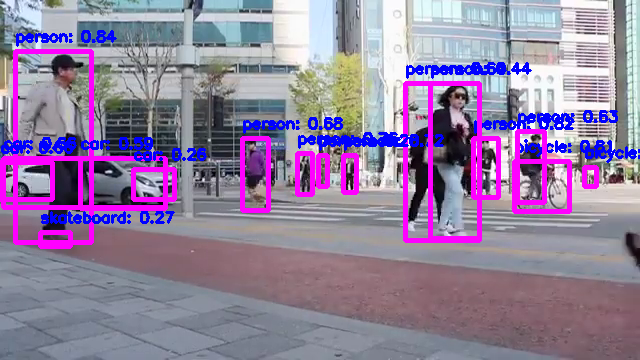


0: 384x640 9 persons, 3 cars, 1 handbag, 1 skateboard, 215.7ms
Confidence ---> 0.88
Class name --> person
Confidence ---> 0.88
Class name --> car
Confidence ---> 0.87
Class name --> person
Confidence ---> 0.87
Class name --> person
Confidence ---> 0.77
Class name --> person
Confidence ---> 0.6
Class name --> person
Confidence ---> 0.56
Class name --> car
Confidence ---> 0.49
Class name --> car
Confidence ---> 0.46
Class name --> person
Confidence ---> 0.44
Class name --> person
Confidence ---> 0.4
Class name --> person
Confidence ---> 0.35
Class name --> skateboard
Confidence ---> 0.32
Class name --> handbag
Confidence ---> 0.27
Class name --> person
Speed: 7.0ms preprocess, 215.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


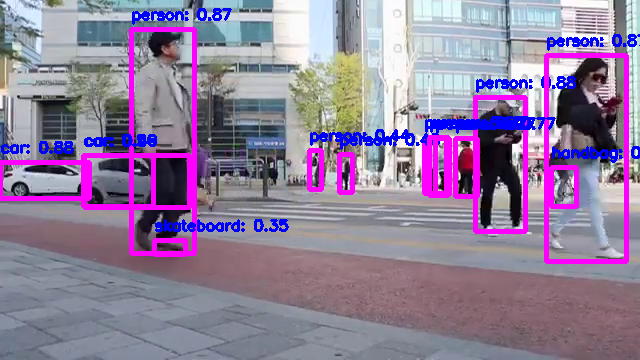


0: 384x640 8 persons, 2 cars, 1 traffic light, 219.2ms
Confidence ---> 0.91
Class name --> person
Confidence ---> 0.88
Class name --> person
Confidence ---> 0.88
Class name --> car
Confidence ---> 0.7
Class name --> person
Confidence ---> 0.7
Class name --> car
Confidence ---> 0.6
Class name --> person
Confidence ---> 0.57
Class name --> traffic light
Confidence ---> 0.52
Class name --> person
Confidence ---> 0.51
Class name --> person
Confidence ---> 0.44
Class name --> person
Confidence ---> 0.35
Class name --> person
Speed: 3.7ms preprocess, 219.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


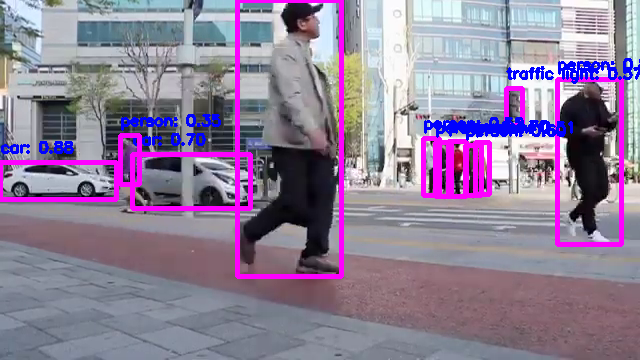


0: 384x640 7 persons, 1 bicycle, 2 cars, 210.1ms
Confidence ---> 0.94
Class name --> person
Confidence ---> 0.85
Class name --> car
Confidence ---> 0.8
Class name --> person
Confidence ---> 0.7
Class name --> person
Confidence ---> 0.65
Class name --> person
Confidence ---> 0.62
Class name --> person
Confidence ---> 0.5
Class name --> person
Confidence ---> 0.39
Class name --> car
Confidence ---> 0.32
Class name --> bicycle
Confidence ---> 0.29
Class name --> person
Speed: 3.7ms preprocess, 210.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


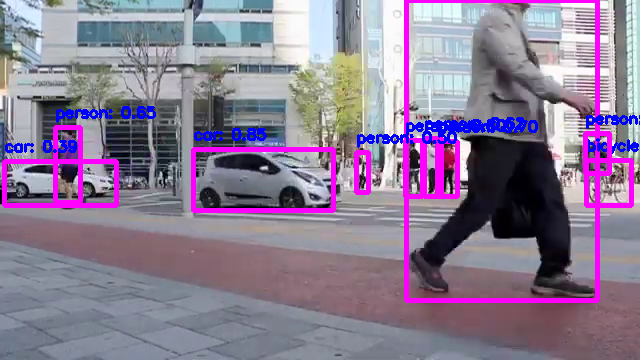


0: 384x640 4 persons, 1 bicycle, 3 cars, 1 traffic light, 208.1ms
Confidence ---> 0.9
Class name --> car
Confidence ---> 0.89
Class name --> car
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.8
Class name --> bicycle
Confidence ---> 0.56
Class name --> person
Confidence ---> 0.47
Class name --> person
Confidence ---> 0.39
Class name --> car
Confidence ---> 0.38
Class name --> traffic light
Confidence ---> 0.38
Class name --> person
Speed: 4.7ms preprocess, 208.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


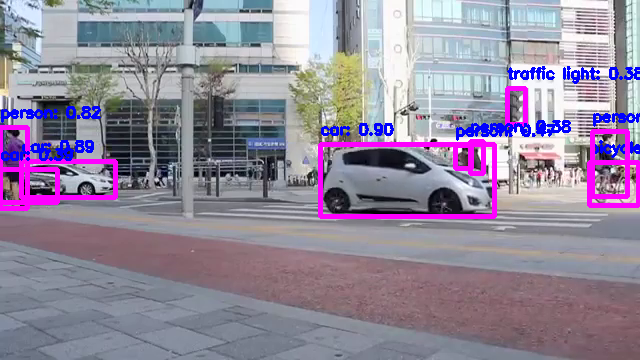


0: 384x640 7 persons, 2 cars, 1 traffic light, 221.4ms
Confidence ---> 0.87
Class name --> car
Confidence ---> 0.81
Class name --> car
Confidence ---> 0.73
Class name --> person
Confidence ---> 0.71
Class name --> person
Confidence ---> 0.69
Class name --> person
Confidence ---> 0.61
Class name --> person
Confidence ---> 0.61
Class name --> person
Confidence ---> 0.58
Class name --> person
Confidence ---> 0.37
Class name --> person
Confidence ---> 0.27
Class name --> traffic light
Speed: 3.8ms preprocess, 221.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


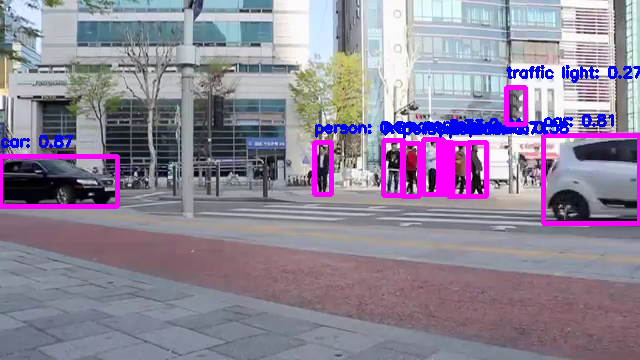


0: 384x640 10 persons, 3 bicycles, 1 car, 209.1ms
Confidence ---> 0.86
Class name --> person
Confidence ---> 0.85
Class name --> car
Confidence ---> 0.73
Class name --> person
Confidence ---> 0.73
Class name --> bicycle
Confidence ---> 0.71
Class name --> person
Confidence ---> 0.71
Class name --> person
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.61
Class name --> person
Confidence ---> 0.6
Class name --> person
Confidence ---> 0.44
Class name --> person
Confidence ---> 0.37
Class name --> bicycle
Confidence ---> 0.35
Class name --> person
Confidence ---> 0.3
Class name --> bicycle
Speed: 3.4ms preprocess, 209.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


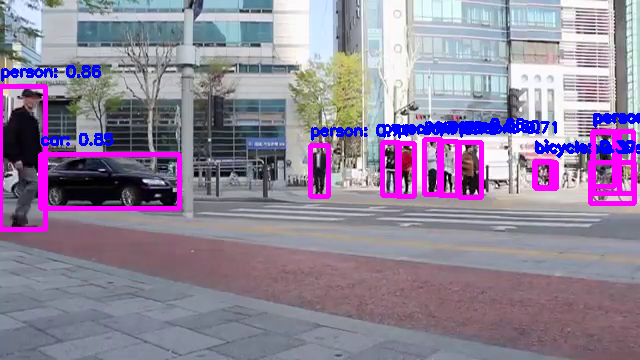


0: 384x640 10 persons, 3 bicycles, 3 cars, 1 traffic light, 221.0ms
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.8
Class name --> person
Confidence ---> 0.8
Class name --> bicycle
Confidence ---> 0.78
Class name --> person
Confidence ---> 0.72
Class name --> person
Confidence ---> 0.7
Class name --> person
Confidence ---> 0.7
Class name --> person
Confidence ---> 0.63
Class name --> person
Confidence ---> 0.59
Class name --> person
Confidence ---> 0.57
Class name --> car
Confidence ---> 0.53
Class name --> car
Confidence ---> 0.48
Class name --> car
Confidence ---> 0.45
Class name --> person
Confidence ---> 0.35
Class name --> person
Confidence ---> 0.29
Class name --> bicycle
Confidence ---> 0.28
Class name --> bicycle
Confidence ---> 0.27
Class name --> traffic light
Speed: 6.9ms preprocess, 221.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


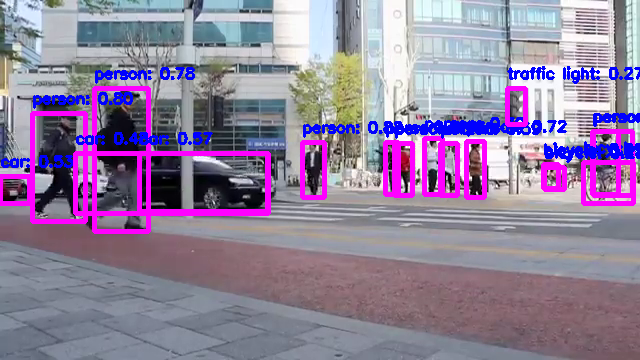


0: 384x640 11 persons, 1 bicycle, 2 cars, 1 traffic light, 212.7ms
Confidence ---> 0.9
Class name --> car
Confidence ---> 0.81
Class name --> person
Confidence ---> 0.8
Class name --> person
Confidence ---> 0.76
Class name --> bicycle
Confidence ---> 0.74
Class name --> person
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.65
Class name --> person
Confidence ---> 0.62
Class name --> person
Confidence ---> 0.61
Class name --> person
Confidence ---> 0.54
Class name --> person
Confidence ---> 0.5
Class name --> car
Confidence ---> 0.46
Class name --> person
Confidence ---> 0.43
Class name --> person
Confidence ---> 0.35
Class name --> traffic light
Confidence ---> 0.27
Class name --> person
Speed: 3.8ms preprocess, 212.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


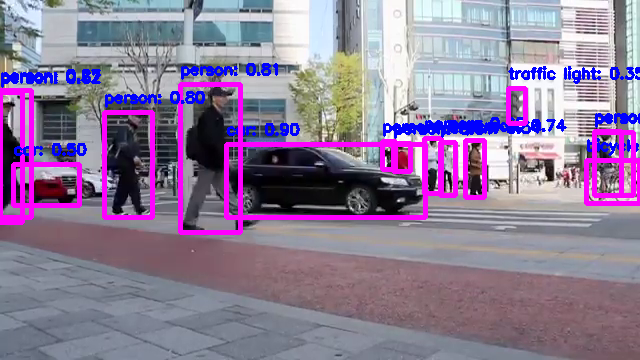


0: 384x640 6 persons, 3 cars, 212.6ms
Confidence ---> 0.95
Class name --> car
Confidence ---> 0.84
Class name --> person
Confidence ---> 0.83
Class name --> person
Confidence ---> 0.76
Class name --> person
Confidence ---> 0.72
Class name --> car
Confidence ---> 0.61
Class name --> person
Confidence ---> 0.31
Class name --> person
Confidence ---> 0.29
Class name --> car
Confidence ---> 0.29
Class name --> person
Speed: 4.9ms preprocess, 212.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


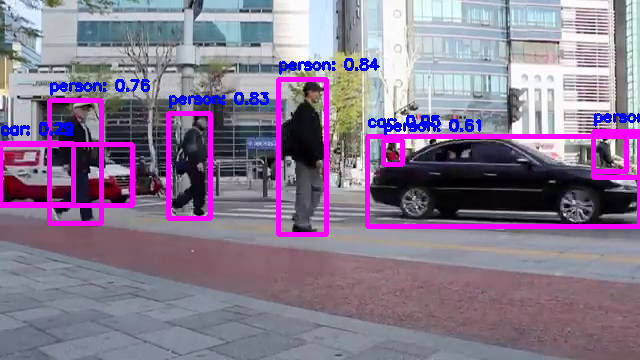


0: 384x640 9 persons, 3 cars, 1 truck, 1 traffic light, 220.7ms
Confidence ---> 0.88
Class name --> person
Confidence ---> 0.83
Class name --> person
Confidence ---> 0.78
Class name --> person
Confidence ---> 0.77
Class name --> car
Confidence ---> 0.76
Class name --> person
Confidence ---> 0.74
Class name --> person
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.61
Class name --> person
Confidence ---> 0.55
Class name --> traffic light
Confidence ---> 0.51
Class name --> car
Confidence ---> 0.47
Class name --> truck
Confidence ---> 0.43
Class name --> car
Confidence ---> 0.32
Class name --> person
Confidence ---> 0.29
Class name --> person
Speed: 3.5ms preprocess, 220.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


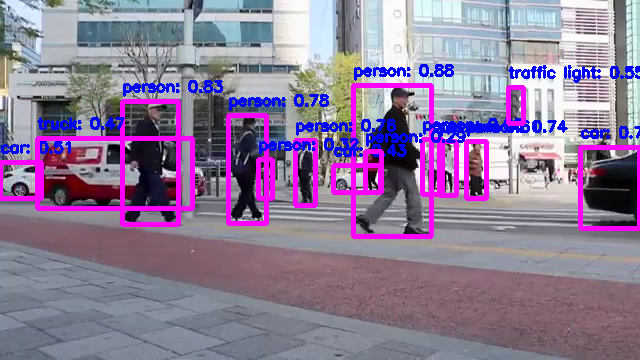


0: 384x640 9 persons, 1 bicycle, 5 cars, 1 traffic light, 209.7ms
Confidence ---> 0.86
Class name --> car
Confidence ---> 0.86
Class name --> person
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.82
Class name --> bicycle
Confidence ---> 0.79
Class name --> person
Confidence ---> 0.77
Class name --> car
Confidence ---> 0.74
Class name --> person
Confidence ---> 0.72
Class name --> car
Confidence ---> 0.65
Class name --> person
Confidence ---> 0.59
Class name --> traffic light
Confidence ---> 0.45
Class name --> person
Confidence ---> 0.33
Class name --> person
Confidence ---> 0.3
Class name --> car
Confidence ---> 0.27
Class name --> person
Confidence ---> 0.26
Class name --> car
Speed: 3.8ms preprocess, 209.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


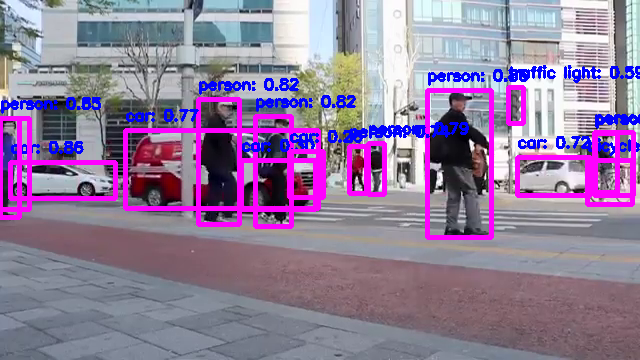


0: 384x640 4 persons, 1 bicycle, 5 cars, 232.4ms
Confidence ---> 0.87
Class name --> person
Confidence ---> 0.8
Class name --> person
Confidence ---> 0.79
Class name --> person
Confidence ---> 0.67
Class name --> person
Confidence ---> 0.64
Class name --> car
Confidence ---> 0.62
Class name --> bicycle
Confidence ---> 0.52
Class name --> car
Confidence ---> 0.44
Class name --> car
Confidence ---> 0.42
Class name --> car
Confidence ---> 0.31
Class name --> car
Speed: 3.4ms preprocess, 232.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


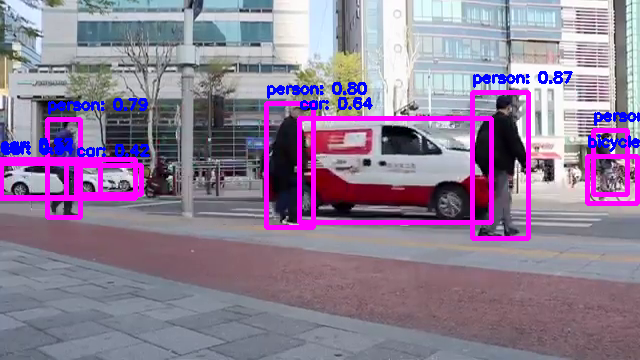


0: 384x640 8 persons, 1 car, 1 truck, 273.6ms
Confidence ---> 0.88
Class name --> car
Confidence ---> 0.85
Class name --> person
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.81
Class name --> person
Confidence ---> 0.77
Class name --> person
Confidence ---> 0.75
Class name --> person
Confidence ---> 0.69
Class name --> truck
Confidence ---> 0.68
Class name --> person
Confidence ---> 0.55
Class name --> person
Confidence ---> 0.34
Class name --> person
Speed: 7.3ms preprocess, 273.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


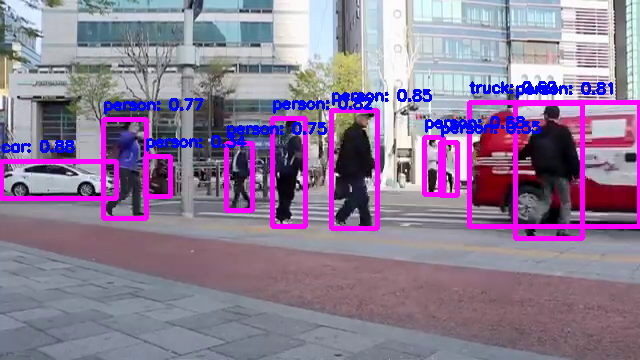


0: 384x640 9 persons, 1 bicycle, 2 cars, 1 traffic light, 1 handbag, 238.0ms
Confidence ---> 0.9
Class name --> person
Confidence ---> 0.89
Class name --> car
Confidence ---> 0.86
Class name --> person
Confidence ---> 0.84
Class name --> person
Confidence ---> 0.8
Class name --> person
Confidence ---> 0.79
Class name --> person
Confidence ---> 0.67
Class name --> person
Confidence ---> 0.58
Class name --> bicycle
Confidence ---> 0.55
Class name --> handbag
Confidence ---> 0.55
Class name --> person
Confidence ---> 0.53
Class name --> person
Confidence ---> 0.49
Class name --> person
Confidence ---> 0.46
Class name --> traffic light
Confidence ---> 0.3
Class name --> car
Speed: 10.9ms preprocess, 238.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


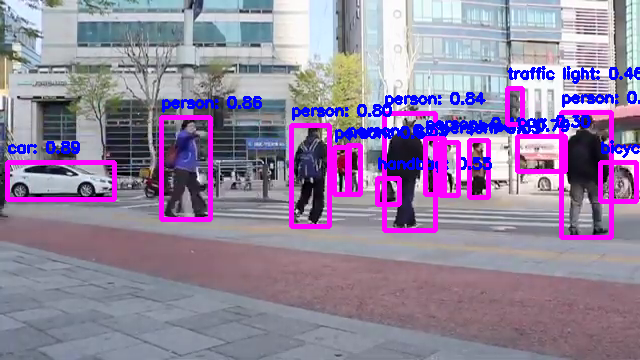


0: 384x640 8 persons, 1 bicycle, 5 cars, 1 bus, 1 backpack, 235.6ms
Confidence ---> 0.85
Class name --> person
Confidence ---> 0.84
Class name --> person
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.81
Class name --> person
Confidence ---> 0.79
Class name --> person
Confidence ---> 0.78
Class name --> person
Confidence ---> 0.77
Class name --> person
Confidence ---> 0.61
Class name --> car
Confidence ---> 0.57
Class name --> person
Confidence ---> 0.51
Class name --> car
Confidence ---> 0.46
Class name --> car
Confidence ---> 0.42
Class name --> bus
Confidence ---> 0.36
Class name --> bicycle
Confidence ---> 0.33
Class name --> backpack
Confidence ---> 0.31
Class name --> car
Confidence ---> 0.31
Class name --> car
Speed: 1.7ms preprocess, 235.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


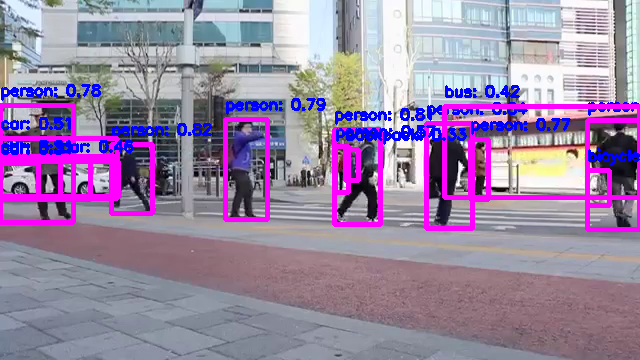


0: 384x640 10 persons, 1 bicycle, 1 car, 1 bus, 244.5ms
Confidence ---> 0.87
Class name --> person
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.78
Class name --> person
Confidence ---> 0.71
Class name --> bus
Confidence ---> 0.7
Class name --> car
Confidence ---> 0.69
Class name --> person
Confidence ---> 0.69
Class name --> person
Confidence ---> 0.67
Class name --> bicycle
Confidence ---> 0.61
Class name --> person
Confidence ---> 0.54
Class name --> person
Confidence ---> 0.43
Class name --> person
Confidence ---> 0.43
Class name --> person
Confidence ---> 0.31
Class name --> person
Speed: 1.7ms preprocess, 244.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


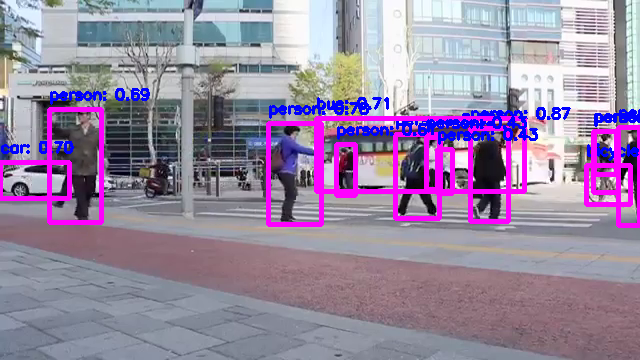


0: 384x640 10 persons, 1 bicycle, 2 cars, 1 bus, 1 traffic light, 1 backpack, 1 handbag, 261.7ms
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.78
Class name --> person
Confidence ---> 0.74
Class name --> bus
Confidence ---> 0.73
Class name --> person
Confidence ---> 0.7
Class name --> person
Confidence ---> 0.64
Class name --> person
Confidence ---> 0.6
Class name --> person
Confidence ---> 0.59
Class name --> traffic light
Confidence ---> 0.51
Class name --> person
Confidence ---> 0.36
Class name --> backpack
Confidence ---> 0.33
Class name --> car
Confidence ---> 0.31
Class name --> car
Confidence ---> 0.3
Class name --> bicycle
Confidence ---> 0.27
Class name --> handbag
Confidence ---> 0.27
Class name --> person
Speed: 1.7ms preprocess, 261.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


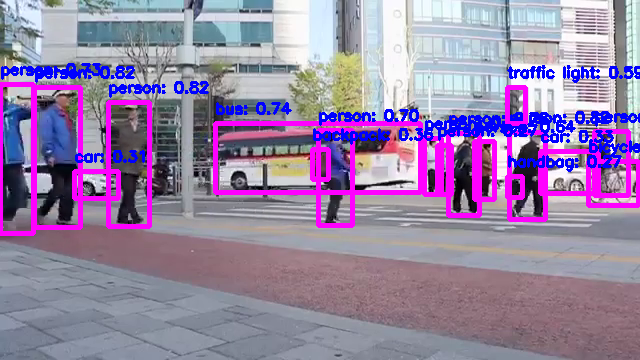


0: 384x640 16 persons, 3 bicycles, 1 bus, 1 traffic light, 1 handbag, 243.7ms
Confidence ---> 0.85
Class name --> person
Confidence ---> 0.84
Class name --> person
Confidence ---> 0.77
Class name --> person
Confidence ---> 0.76
Class name --> person
Confidence ---> 0.73
Class name --> person
Confidence ---> 0.72
Class name --> person
Confidence ---> 0.71
Class name --> person
Confidence ---> 0.71
Class name --> person
Confidence ---> 0.71
Class name --> person
Confidence ---> 0.67
Class name --> person
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.61
Class name --> person
Confidence ---> 0.5
Class name --> bicycle
Confidence ---> 0.48
Class name --> person
Confidence ---> 0.48
Class name --> bus
Confidence ---> 0.47
Class name --> traffic light
Confidence ---> 0.36
Class name --> person
Confidence ---> 0.35
Class name --> bicycle
Confidence ---> 0.34
Class name --> handbag
Confidence ---> 0.33
Class name --> person
Confidence ---> 0.31
Class name --> person
Confidence -

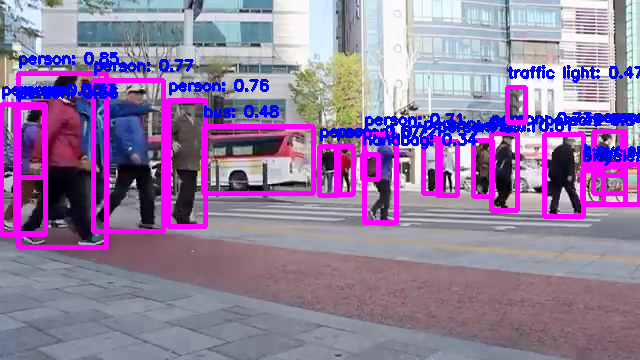


0: 384x640 12 persons, 1 bicycle, 2 cars, 1 traffic light, 224.0ms
Confidence ---> 0.89
Class name --> car
Confidence ---> 0.87
Class name --> person
Confidence ---> 0.85
Class name --> person
Confidence ---> 0.83
Class name --> person
Confidence ---> 0.83
Class name --> person
Confidence ---> 0.78
Class name --> person
Confidence ---> 0.78
Class name --> person
Confidence ---> 0.76
Class name --> person
Confidence ---> 0.75
Class name --> person
Confidence ---> 0.71
Class name --> person
Confidence ---> 0.7
Class name --> traffic light
Confidence ---> 0.5
Class name --> person
Confidence ---> 0.41
Class name --> person
Confidence ---> 0.39
Class name --> car
Confidence ---> 0.37
Class name --> person
Confidence ---> 0.35
Class name --> bicycle
Speed: 1.8ms preprocess, 224.0ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


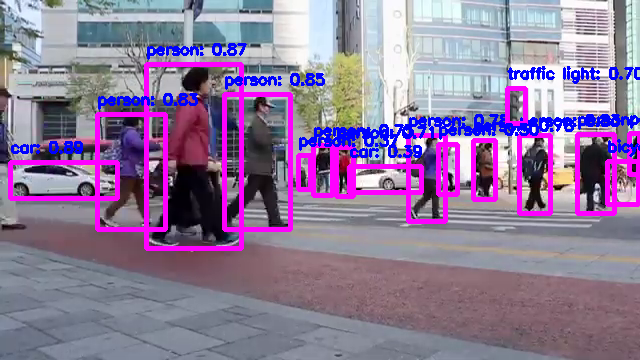


0: 384x640 11 persons, 3 bicycles, 4 cars, 1 traffic light, 1 backpack, 2 handbags, 1 skateboard, 223.0ms
Confidence ---> 0.84
Class name --> person
Confidence ---> 0.84
Class name --> person
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.81
Class name --> person
Confidence ---> 0.79
Class name --> person
Confidence ---> 0.69
Class name --> person
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.65
Class name --> person
Confidence ---> 0.63
Class name --> traffic light
Confidence ---> 0.6
Class name --> person
Confidence ---> 0.59
Class name --> car
Confidence ---> 0.55
Class name --> bicycle
Confidence ---> 0.53
Class name --> backpack
Confidence ---> 0.46
Class name --> skateboard
Confidence ---> 0.44
Class name --> car
Confidence ---> 0.42
Class name --> bicycle
Confidence ---> 0.4
Class name --> car
Confidence ---> 0.37
Class name --> car
Confidence ---> 0.37
Class name --> handbag
Confidence ---> 0.34
Class name --> person
Confidence ---> 0.32
Class name

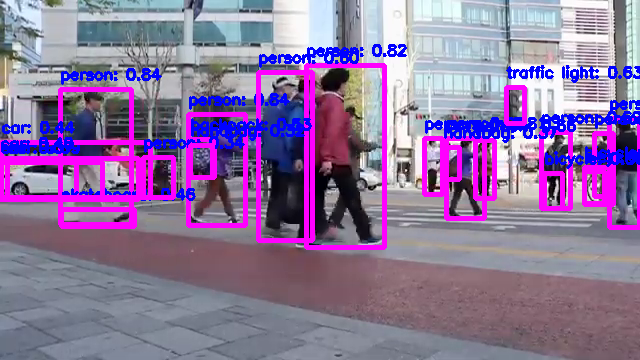


0: 384x640 12 persons, 2 cars, 1 traffic light, 2 skateboards, 236.3ms
Confidence ---> 0.89
Class name --> person
Confidence ---> 0.85
Class name --> person
Confidence ---> 0.83
Class name --> person
Confidence ---> 0.81
Class name --> person
Confidence ---> 0.8
Class name --> person
Confidence ---> 0.8
Class name --> person
Confidence ---> 0.79
Class name --> person
Confidence ---> 0.75
Class name --> car
Confidence ---> 0.63
Class name --> person
Confidence ---> 0.6
Class name --> person
Confidence ---> 0.6
Class name --> skateboard
Confidence ---> 0.46
Class name --> person
Confidence ---> 0.44
Class name --> person
Confidence ---> 0.43
Class name --> person
Confidence ---> 0.34
Class name --> car
Confidence ---> 0.32
Class name --> traffic light
Confidence ---> 0.29
Class name --> skateboard
Speed: 1.8ms preprocess, 236.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


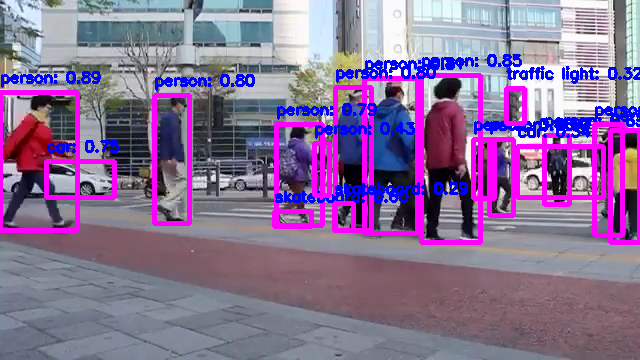


0: 384x640 12 persons, 2 cars, 1 suitcase, 1 skateboard, 210.5ms
Confidence ---> 0.92
Class name --> person
Confidence ---> 0.9
Class name --> person
Confidence ---> 0.88
Class name --> car
Confidence ---> 0.87
Class name --> person
Confidence ---> 0.87
Class name --> person
Confidence ---> 0.77
Class name --> person
Confidence ---> 0.74
Class name --> person
Confidence ---> 0.73
Class name --> person
Confidence ---> 0.71
Class name --> person
Confidence ---> 0.69
Class name --> person
Confidence ---> 0.52
Class name --> skateboard
Confidence ---> 0.46
Class name --> suitcase
Confidence ---> 0.46
Class name --> person
Confidence ---> 0.43
Class name --> person
Confidence ---> 0.42
Class name --> person
Confidence ---> 0.28
Class name --> car
Speed: 3.8ms preprocess, 210.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


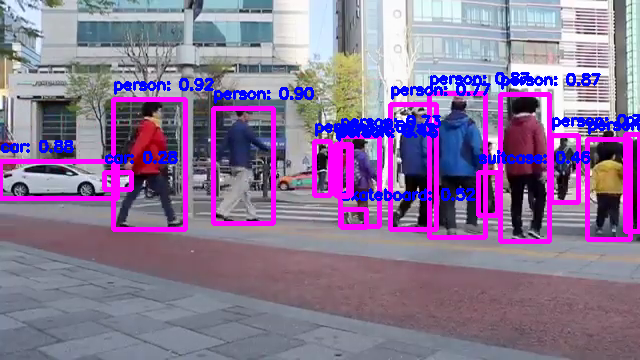


0: 384x640 13 persons, 4 cars, 1 handbag, 1 skateboard, 222.1ms
Confidence ---> 0.89
Class name --> car
Confidence ---> 0.89
Class name --> person
Confidence ---> 0.87
Class name --> person
Confidence ---> 0.86
Class name --> person
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.74
Class name --> person
Confidence ---> 0.72
Class name --> person
Confidence ---> 0.71
Class name --> person
Confidence ---> 0.71
Class name --> person
Confidence ---> 0.69
Class name --> person
Confidence ---> 0.67
Class name --> person
Confidence ---> 0.65
Class name --> person
Confidence ---> 0.64
Class name --> car
Confidence ---> 0.62
Class name --> person
Confidence ---> 0.46
Class name --> car
Confidence ---> 0.36
Class name --> person
Confidence ---> 0.32
Class name --> handbag
Confidence ---> 0.3
Class name --> skateboard
Confidence ---> 0.29
Class name --> car
Speed: 1.8ms preprocess, 222.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


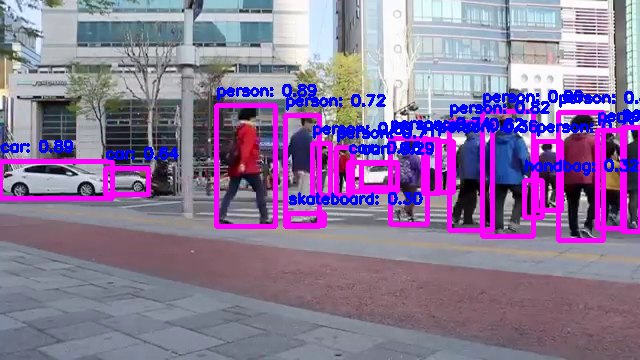


0: 384x640 9 persons, 4 cars, 1 backpack, 197.5ms
Confidence ---> 0.88
Class name --> person
Confidence ---> 0.86
Class name --> person
Confidence ---> 0.84
Class name --> person
Confidence ---> 0.81
Class name --> person
Confidence ---> 0.8
Class name --> person
Confidence ---> 0.79
Class name --> person
Confidence ---> 0.78
Class name --> car
Confidence ---> 0.69
Class name --> person
Confidence ---> 0.66
Class name --> car
Confidence ---> 0.6
Class name --> person
Confidence ---> 0.6
Class name --> car
Confidence ---> 0.57
Class name --> person
Confidence ---> 0.47
Class name --> backpack
Confidence ---> 0.26
Class name --> car
Speed: 1.8ms preprocess, 197.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


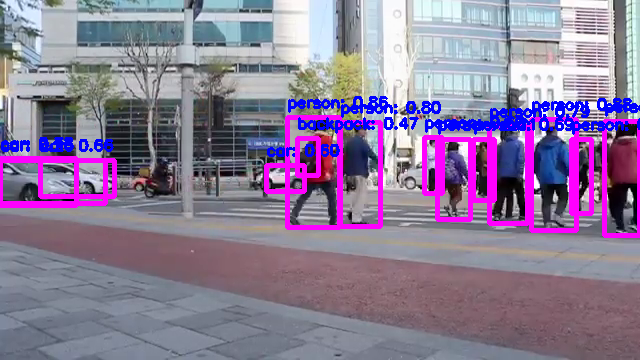


0: 384x640 11 persons, 5 cars, 1 traffic light, 228.9ms
Confidence ---> 0.85
Class name --> car
Confidence ---> 0.84
Class name --> person
Confidence ---> 0.8
Class name --> person
Confidence ---> 0.79
Class name --> person
Confidence ---> 0.79
Class name --> person
Confidence ---> 0.77
Class name --> person
Confidence ---> 0.76
Class name --> person
Confidence ---> 0.7
Class name --> person
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.65
Class name --> traffic light
Confidence ---> 0.64
Class name --> person
Confidence ---> 0.62
Class name --> person
Confidence ---> 0.41
Class name --> car
Confidence ---> 0.41
Class name --> car
Confidence ---> 0.4
Class name --> car
Confidence ---> 0.36
Class name --> car
Confidence ---> 0.34
Class name --> person
Speed: 1.9ms preprocess, 228.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


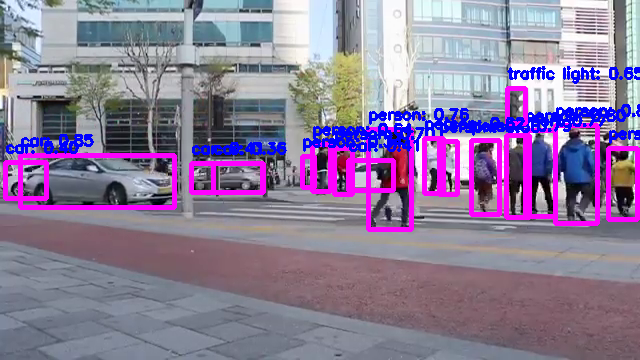


0: 384x640 11 persons, 5 cars, 1 traffic light, 207.2ms
Confidence ---> 0.91
Class name --> car
Confidence ---> 0.91
Class name --> car
Confidence ---> 0.85
Class name --> person
Confidence ---> 0.85
Class name --> person
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.78
Class name --> person
Confidence ---> 0.75
Class name --> person
Confidence ---> 0.74
Class name --> person
Confidence ---> 0.74
Class name --> person
Confidence ---> 0.71
Class name --> traffic light
Confidence ---> 0.69
Class name --> person
Confidence ---> 0.58
Class name --> person
Confidence ---> 0.43
Class name --> person
Confidence ---> 0.39
Class name --> car
Confidence ---> 0.3
Class name --> car
Confidence ---> 0.29
Class name --> person
Confidence ---> 0.27
Class name --> car
Speed: 1.7ms preprocess, 207.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


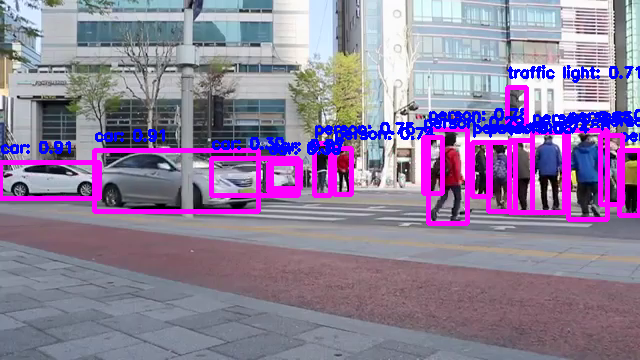


0: 384x640 13 persons, 3 cars, 1 traffic light, 209.8ms
Confidence ---> 0.89
Class name --> car
Confidence ---> 0.89
Class name --> car
Confidence ---> 0.84
Class name --> person
Confidence ---> 0.79
Class name --> person
Confidence ---> 0.75
Class name --> person
Confidence ---> 0.73
Class name --> person
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.66
Class name --> traffic light
Confidence ---> 0.61
Class name --> person
Confidence ---> 0.61
Class name --> person
Confidence ---> 0.61
Class name --> person
Confidence ---> 0.58
Class name --> car
Confidence ---> 0.46
Class name --> person
Confidence ---> 0.46
Class name --> person
Confidence ---> 0.31
Class name --> person
Confidence ---> 0.28
Class name --> person
Confidence ---> 0.26
Class name --> person
Speed: 1.6ms preprocess, 209.8ms inference, 4.5ms postprocess per image at shape (1, 3, 384, 640)


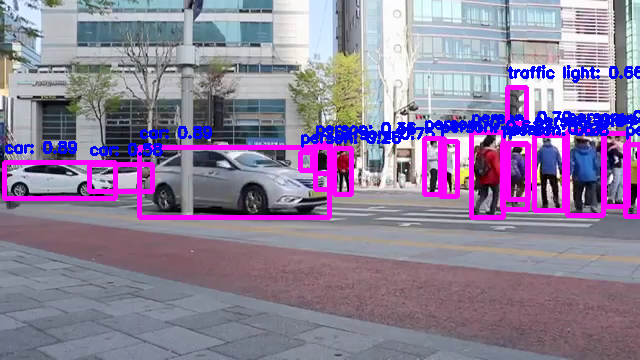


0: 384x640 12 persons, 4 cars, 1 traffic light, 202.9ms
Confidence ---> 0.91
Class name --> car
Confidence ---> 0.86
Class name --> car
Confidence ---> 0.79
Class name --> person
Confidence ---> 0.78
Class name --> person
Confidence ---> 0.73
Class name --> person
Confidence ---> 0.69
Class name --> person
Confidence ---> 0.69
Class name --> person
Confidence ---> 0.67
Class name --> traffic light
Confidence ---> 0.62
Class name --> person
Confidence ---> 0.6
Class name --> person
Confidence ---> 0.56
Class name --> person
Confidence ---> 0.56
Class name --> person
Confidence ---> 0.45
Class name --> person
Confidence ---> 0.39
Class name --> car
Confidence ---> 0.35
Class name --> person
Confidence ---> 0.31
Class name --> car
Confidence ---> 0.27
Class name --> person
Speed: 1.7ms preprocess, 202.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


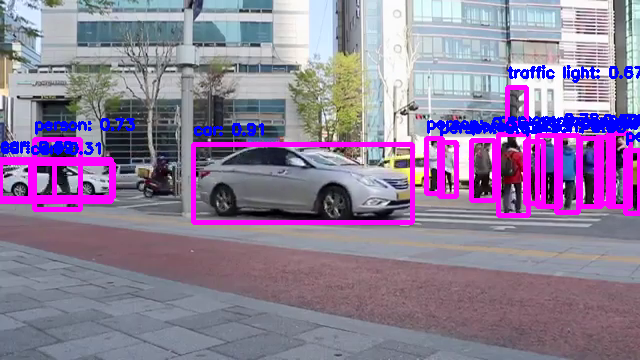


0: 384x640 8 persons, 2 cars, 1 traffic light, 213.2ms
Confidence ---> 0.94
Class name --> car
Confidence ---> 0.9
Class name --> car
Confidence ---> 0.67
Class name --> person
Confidence ---> 0.67
Class name --> person
Confidence ---> 0.67
Class name --> person
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.59
Class name --> person
Confidence ---> 0.57
Class name --> person
Confidence ---> 0.54
Class name --> traffic light
Confidence ---> 0.49
Class name --> person
Confidence ---> 0.49
Class name --> person
Speed: 1.8ms preprocess, 213.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


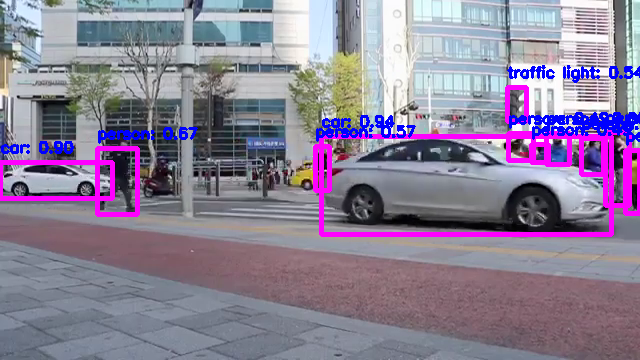


0: 384x640 12 persons, 4 cars, 1 traffic light, 228.1ms
Confidence ---> 0.9
Class name --> car
Confidence ---> 0.72
Class name --> car
Confidence ---> 0.72
Class name --> person
Confidence ---> 0.7
Class name --> person
Confidence ---> 0.7
Class name --> person
Confidence ---> 0.69
Class name --> person
Confidence ---> 0.64
Class name --> traffic light
Confidence ---> 0.6
Class name --> person
Confidence ---> 0.56
Class name --> person
Confidence ---> 0.54
Class name --> person
Confidence ---> 0.51
Class name --> car
Confidence ---> 0.5
Class name --> car
Confidence ---> 0.47
Class name --> person
Confidence ---> 0.38
Class name --> person
Confidence ---> 0.32
Class name --> person
Confidence ---> 0.31
Class name --> person
Confidence ---> 0.26
Class name --> person
Speed: 3.9ms preprocess, 228.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


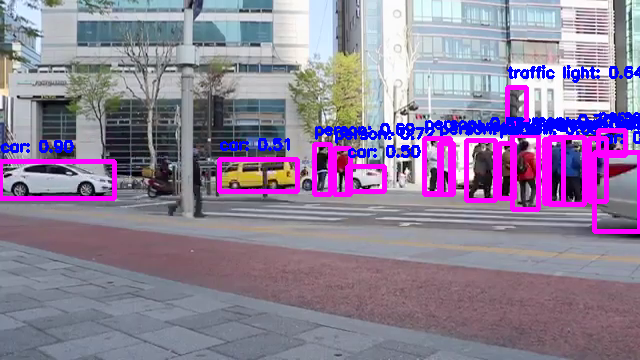


0: 384x640 16 persons, 4 cars, 1 traffic light, 211.7ms
Confidence ---> 0.89
Class name --> car
Confidence ---> 0.71
Class name --> person
Confidence ---> 0.71
Class name --> traffic light
Confidence ---> 0.7
Class name --> person
Confidence ---> 0.68
Class name --> person
Confidence ---> 0.68
Class name --> person
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.63
Class name --> person
Confidence ---> 0.62
Class name --> person
Confidence ---> 0.57
Class name --> person
Confidence ---> 0.56
Class name --> person
Confidence ---> 0.51
Class name --> car
Confidence ---> 0.5
Class name --> person
Confidence ---> 0.45
Class name --> person
Confidence ---> 0.44
Class name --> person
Confidence ---> 0.42
Class name --> person
Confidence ---> 0.41
Class name --> person
Confidence ---> 0.35
Class name --> person
Confidence ---> 0.34
Class name --> car
Confidence ---> 0.32
Class name --> person
Confidence ---> 0.31
Class name --> car
Speed: 1.9ms preprocess, 211.7ms inference, 1.4

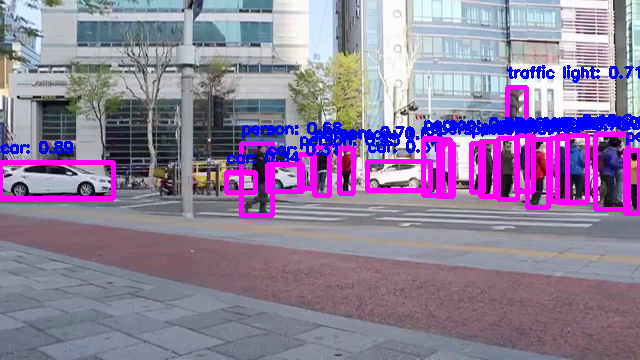


0: 384x640 14 persons, 2 cars, 1 traffic light, 221.4ms
Confidence ---> 0.89
Class name --> car
Confidence ---> 0.69
Class name --> person
Confidence ---> 0.67
Class name --> traffic light
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.64
Class name --> person
Confidence ---> 0.63
Class name --> person
Confidence ---> 0.59
Class name --> person
Confidence ---> 0.57
Class name --> person
Confidence ---> 0.56
Class name --> car
Confidence ---> 0.54
Class name --> person
Confidence ---> 0.49
Class name --> person
Confidence ---> 0.47
Class name --> person
Confidence ---> 0.45
Class name --> person
Confidence ---> 0.42
Class name --> person
Confidence ---> 0.4
Class name --> person
Confidence ---> 0.36
Class name --> person
Confidence ---> 0.29
Class name --> person
Speed: 1.7ms preprocess, 221.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


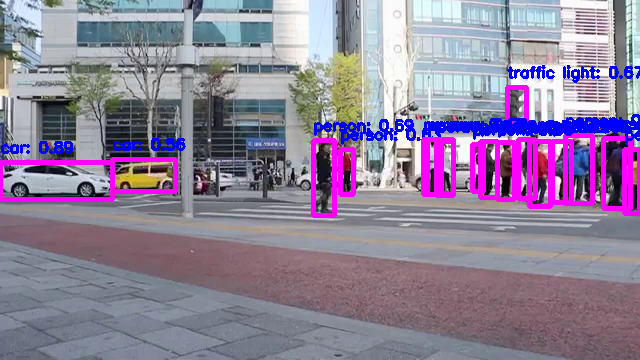


0: 384x640 15 persons, 5 cars, 1 traffic light, 207.1ms
Confidence ---> 0.89
Class name --> car
Confidence ---> 0.85
Class name --> car
Confidence ---> 0.78
Class name --> car
Confidence ---> 0.75
Class name --> person
Confidence ---> 0.73
Class name --> person
Confidence ---> 0.68
Class name --> person
Confidence ---> 0.67
Class name --> person
Confidence ---> 0.67
Class name --> traffic light
Confidence ---> 0.59
Class name --> person
Confidence ---> 0.59
Class name --> person
Confidence ---> 0.57
Class name --> person
Confidence ---> 0.56
Class name --> person
Confidence ---> 0.54
Class name --> person
Confidence ---> 0.51
Class name --> person
Confidence ---> 0.49
Class name --> person
Confidence ---> 0.46
Class name --> person
Confidence ---> 0.36
Class name --> car
Confidence ---> 0.36
Class name --> person
Confidence ---> 0.35
Class name --> person
Confidence ---> 0.29
Class name --> person
Confidence ---> 0.29
Class name --> car
Speed: 1.7ms preprocess, 207.1ms inference, 1.5m

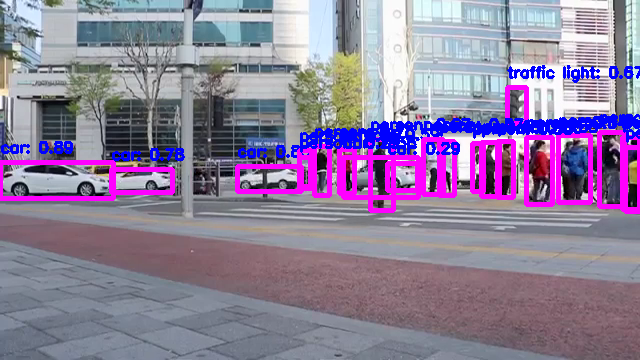


0: 384x640 11 persons, 3 cars, 1 traffic light, 201.6ms
Confidence ---> 0.89
Class name --> car
Confidence ---> 0.75
Class name --> person
Confidence ---> 0.7
Class name --> person
Confidence ---> 0.69
Class name --> person
Confidence ---> 0.69
Class name --> person
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.62
Class name --> person
Confidence ---> 0.6
Class name --> traffic light
Confidence ---> 0.55
Class name --> person
Confidence ---> 0.53
Class name --> person
Confidence ---> 0.5
Class name --> person
Confidence ---> 0.48
Class name --> person
Confidence ---> 0.35
Class name --> car
Confidence ---> 0.32
Class name --> person
Confidence ---> 0.29
Class name --> car
Speed: 1.8ms preprocess, 201.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


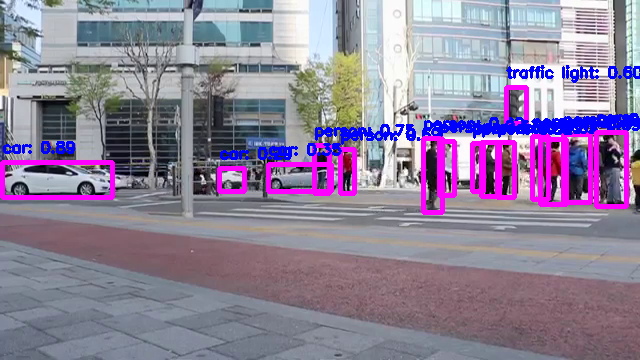


0: 384x640 11 persons, 5 cars, 1 traffic light, 216.2ms
Confidence ---> 0.9
Class name --> car
Confidence ---> 0.72
Class name --> person
Confidence ---> 0.7
Class name --> person
Confidence ---> 0.68
Class name --> person
Confidence ---> 0.67
Class name --> car
Confidence ---> 0.67
Class name --> person
Confidence ---> 0.66
Class name --> traffic light
Confidence ---> 0.64
Class name --> person
Confidence ---> 0.62
Class name --> person
Confidence ---> 0.59
Class name --> person
Confidence ---> 0.56
Class name --> person
Confidence ---> 0.56
Class name --> person
Confidence ---> 0.55
Class name --> person
Confidence ---> 0.5
Class name --> car
Confidence ---> 0.39
Class name --> car
Confidence ---> 0.31
Class name --> car
Confidence ---> 0.26
Class name --> person
Speed: 1.7ms preprocess, 216.2ms inference, 3.4ms postprocess per image at shape (1, 3, 384, 640)


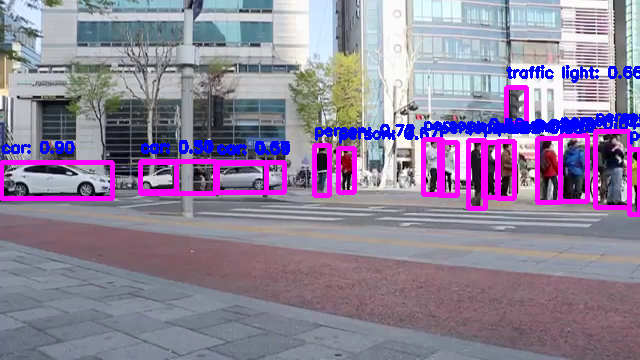


0: 384x640 13 persons, 4 cars, 1 traffic light, 245.5ms
Confidence ---> 0.88
Class name --> car
Confidence ---> 0.7
Class name --> person
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.64
Class name --> traffic light
Confidence ---> 0.63
Class name --> person
Confidence ---> 0.63
Class name --> car
Confidence ---> 0.62
Class name --> person
Confidence ---> 0.57
Class name --> person
Confidence ---> 0.56
Class name --> person
Confidence ---> 0.5
Class name --> person
Confidence ---> 0.48
Class name --> person
Confidence ---> 0.43
Class name --> car
Confidence ---> 0.42
Class name --> person
Confidence ---> 0.37
Class name --> person
Confidence ---> 0.37
Class name --> car
Confidence ---> 0.36
Class name --> person
Confidence ---> 0.35
Class name --> person
Confidence ---> 0.27
Class name --> person
Speed: 1.7ms preprocess, 245.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


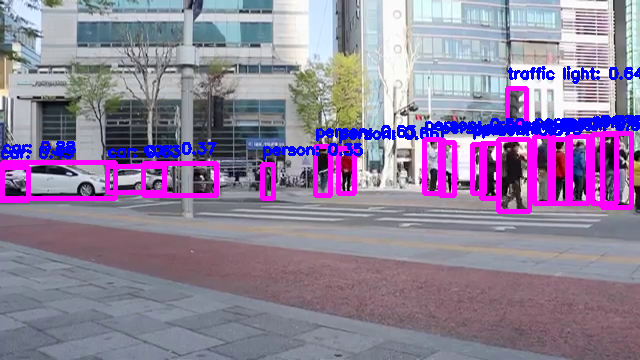


0: 384x640 12 persons, 3 cars, 1 traffic light, 247.9ms
Confidence ---> 0.88
Class name --> car
Confidence ---> 0.76
Class name --> car
Confidence ---> 0.71
Class name --> person
Confidence ---> 0.68
Class name --> person
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.65
Class name --> person
Confidence ---> 0.6
Class name --> traffic light
Confidence ---> 0.56
Class name --> person
Confidence ---> 0.52
Class name --> person
Confidence ---> 0.51
Class name --> person
Confidence ---> 0.43
Class name --> person
Confidence ---> 0.41
Class name --> person
Confidence ---> 0.4
Class name --> person
Confidence ---> 0.4
Class name --> person
Confidence ---> 0.32
Class name --> person
Confidence ---> 0.27
Class name --> car
Speed: 1.8ms preprocess, 247.9ms inference, 5.4ms postprocess per image at shape (1, 3, 384, 640)


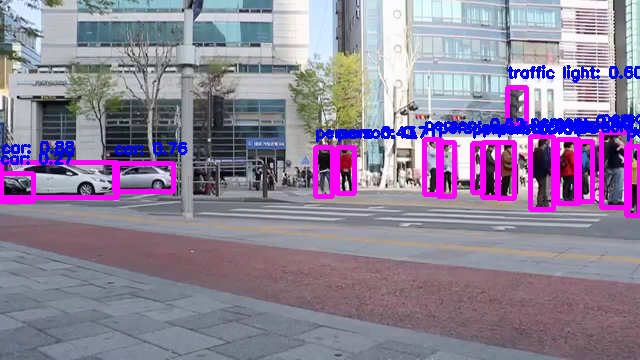


0: 384x640 12 persons, 3 cars, 1 traffic light, 255.4ms
Confidence ---> 0.89
Class name --> car
Confidence ---> 0.71
Class name --> person
Confidence ---> 0.7
Class name --> person
Confidence ---> 0.67
Class name --> person
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.65
Class name --> traffic light
Confidence ---> 0.63
Class name --> car
Confidence ---> 0.61
Class name --> person
Confidence ---> 0.55
Class name --> person
Confidence ---> 0.53
Class name --> person
Confidence ---> 0.45
Class name --> person
Confidence ---> 0.43
Class name --> person
Confidence ---> 0.42
Class name --> person
Confidence ---> 0.35
Class name --> person
Confidence ---> 0.3
Class name --> car
Confidence ---> 0.26
Class name --> person
Speed: 3.1ms preprocess, 255.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


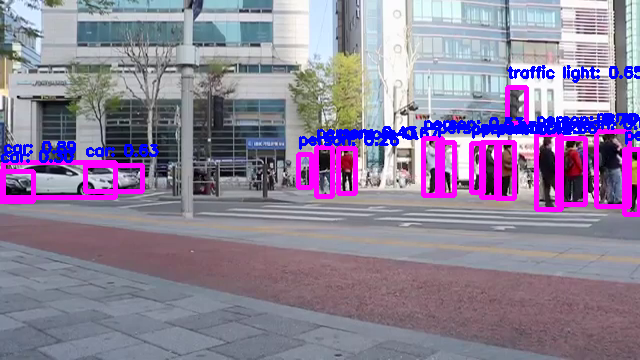


0: 384x640 14 persons, 1 car, 1 traffic light, 248.3ms
Confidence ---> 0.89
Class name --> car
Confidence ---> 0.74
Class name --> person
Confidence ---> 0.73
Class name --> person
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.64
Class name --> person
Confidence ---> 0.64
Class name --> person
Confidence ---> 0.63
Class name --> person
Confidence ---> 0.59
Class name --> traffic light
Confidence ---> 0.56
Class name --> person
Confidence ---> 0.56
Class name --> person
Confidence ---> 0.52
Class name --> person
Confidence ---> 0.51
Class name --> person
Confidence ---> 0.49
Class name --> person
Confidence ---> 0.44
Class name --> person
Confidence ---> 0.33
Class name --> person
Confidence ---> 0.26
Class name --> person
Speed: 3.8ms preprocess, 248.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


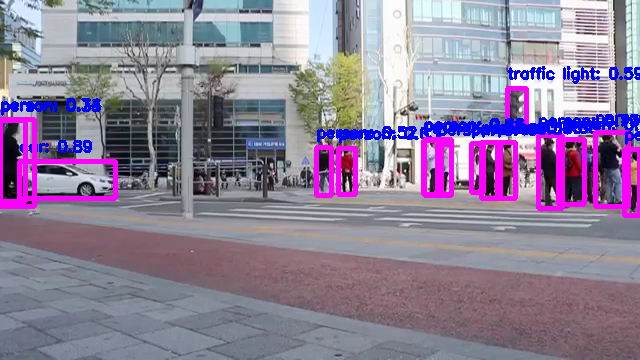


0: 384x640 14 persons, 4 cars, 1 traffic light, 246.0ms
Confidence ---> 0.78
Class name --> person
Confidence ---> 0.69
Class name --> person
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.65
Class name --> person
Confidence ---> 0.64
Class name --> person
Confidence ---> 0.63
Class name --> traffic light
Confidence ---> 0.57
Class name --> person
Confidence ---> 0.56
Class name --> person
Confidence ---> 0.52
Class name --> person
Confidence ---> 0.49
Class name --> car
Confidence ---> 0.48
Class name --> person
Confidence ---> 0.48
Class name --> person
Confidence ---> 0.47
Class name --> person
Confidence ---> 0.39
Class name --> person
Confidence ---> 0.39
Class name --> car
Confidence ---> 0.33
Class name --> person
Confidence ---> 0.32
Class name --> car
Confidence ---> 0.29
Class name --> car
Confidence ---> 0.28
Class name --> person
Speed: 2.0ms preprocess, 246.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


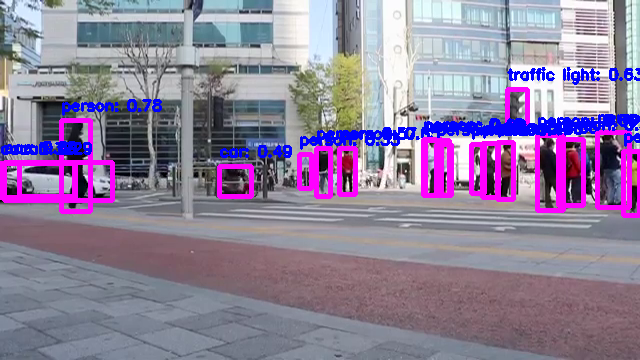


0: 384x640 14 persons, 2 cars, 1 traffic light, 229.4ms
Confidence ---> 0.91
Class name --> car
Confidence ---> 0.73
Class name --> car
Confidence ---> 0.71
Class name --> person
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.65
Class name --> person
Confidence ---> 0.61
Class name --> traffic light
Confidence ---> 0.58
Class name --> person
Confidence ---> 0.54
Class name --> person
Confidence ---> 0.54
Class name --> person
Confidence ---> 0.54
Class name --> person
Confidence ---> 0.52
Class name --> person
Confidence ---> 0.5
Class name --> person
Confidence ---> 0.5
Class name --> person
Confidence ---> 0.33
Class name --> person
Confidence ---> 0.31
Class name --> person
Confidence ---> 0.31
Class name --> person
Confidence ---> 0.29
Class name --> person
Speed: 1.8ms preprocess, 229.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


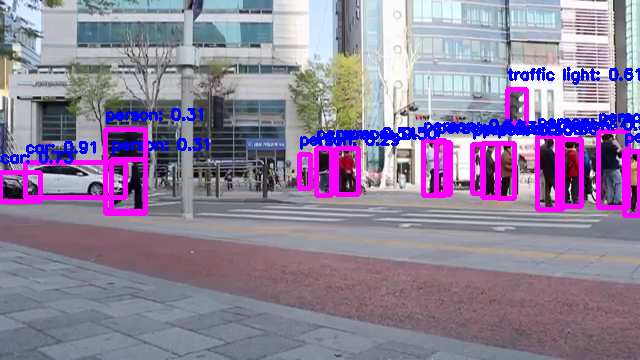


0: 384x640 14 persons, 2 cars, 1 traffic light, 183.8ms
Confidence ---> 0.88
Class name --> car
Confidence ---> 0.7
Class name --> person
Confidence ---> 0.68
Class name --> person
Confidence ---> 0.67
Class name --> person
Confidence ---> 0.66
Class name --> car
Confidence ---> 0.63
Class name --> person
Confidence ---> 0.6
Class name --> person
Confidence ---> 0.59
Class name --> traffic light
Confidence ---> 0.59
Class name --> person
Confidence ---> 0.58
Class name --> person
Confidence ---> 0.54
Class name --> person
Confidence ---> 0.52
Class name --> person
Confidence ---> 0.47
Class name --> person
Confidence ---> 0.41
Class name --> person
Confidence ---> 0.36
Class name --> person
Confidence ---> 0.35
Class name --> person
Confidence ---> 0.32
Class name --> person
Speed: 1.8ms preprocess, 183.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


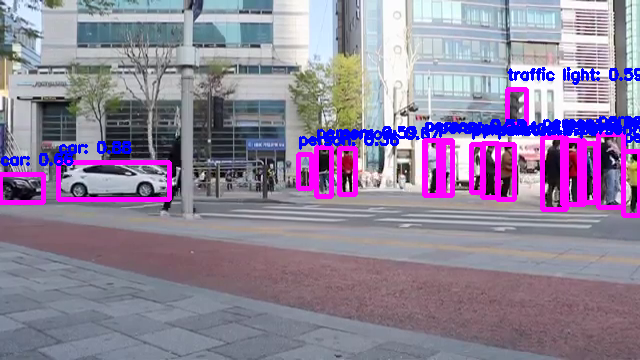


0: 384x640 13 persons, 2 cars, 1 traffic light, 206.8ms
Confidence ---> 0.87
Class name --> car
Confidence ---> 0.82
Class name --> person
Confidence ---> 0.77
Class name --> person
Confidence ---> 0.73
Class name --> person
Confidence ---> 0.73
Class name --> person
Confidence ---> 0.7
Class name --> person
Confidence ---> 0.7
Class name --> person
Confidence ---> 0.68
Class name --> person
Confidence ---> 0.67
Class name --> traffic light
Confidence ---> 0.66
Class name --> person
Confidence ---> 0.64
Class name --> person
Confidence ---> 0.33
Class name --> person
Confidence ---> 0.31
Class name --> person
Confidence ---> 0.31
Class name --> person
Confidence ---> 0.28
Class name --> person
Confidence ---> 0.28
Class name --> car
Speed: 1.9ms preprocess, 206.8ms inference, 5.3ms postprocess per image at shape (1, 3, 384, 640)


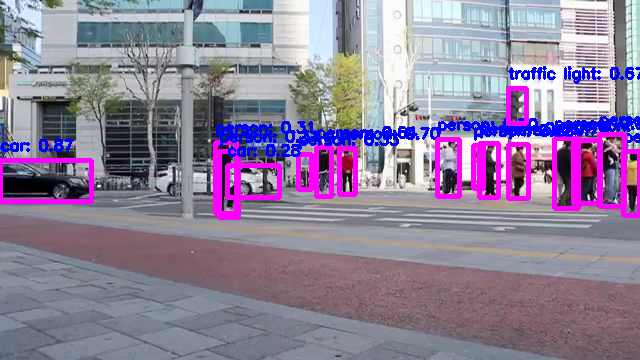


0: 384x640 12 persons, 5 cars, 1 traffic light, 226.5ms
Confidence ---> 0.87
Class name --> car
Confidence ---> 0.86
Class name --> person
Confidence ---> 0.81
Class name --> person
Confidence ---> 0.74
Class name --> person
Confidence ---> 0.73
Class name --> car
Confidence ---> 0.71
Class name --> person
Confidence ---> 0.67
Class name --> traffic light
Confidence ---> 0.59
Class name --> person
Confidence ---> 0.59
Class name --> person
Confidence ---> 0.55
Class name --> person
Confidence ---> 0.54
Class name --> person
Confidence ---> 0.52
Class name --> person
Confidence ---> 0.51
Class name --> person
Confidence ---> 0.43
Class name --> car
Confidence ---> 0.35
Class name --> car
Confidence ---> 0.31
Class name --> person
Confidence ---> 0.3
Class name --> car
Confidence ---> 0.27
Class name --> person
Speed: 1.9ms preprocess, 226.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


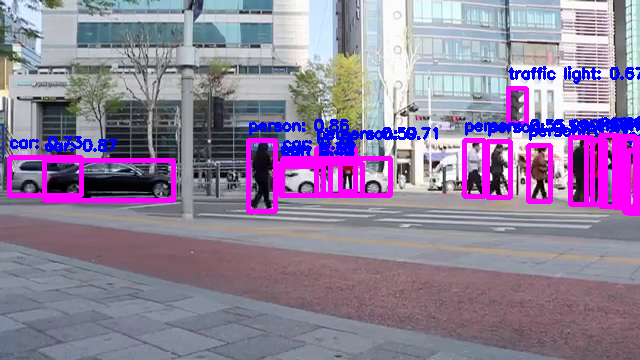


0: 384x640 10 persons, 3 cars, 1 traffic light, 234.1ms
Confidence ---> 0.87
Class name --> person
Confidence ---> 0.85
Class name --> car
Confidence ---> 0.8
Class name --> person
Confidence ---> 0.75
Class name --> person
Confidence ---> 0.68
Class name --> traffic light
Confidence ---> 0.65
Class name --> person
Confidence ---> 0.6
Class name --> person
Confidence ---> 0.56
Class name --> person
Confidence ---> 0.56
Class name --> person
Confidence ---> 0.43
Class name --> person
Confidence ---> 0.38
Class name --> person
Confidence ---> 0.36
Class name --> person
Confidence ---> 0.32
Class name --> car
Confidence ---> 0.28
Class name --> car
Speed: 1.8ms preprocess, 234.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


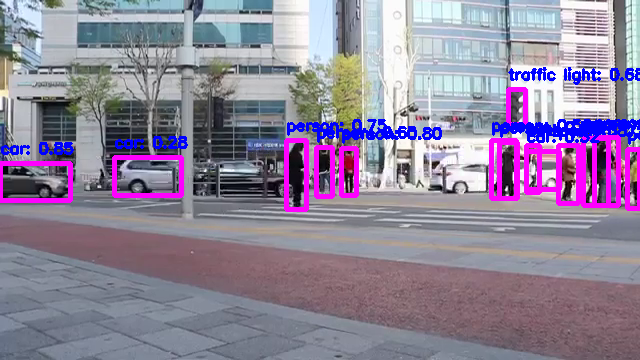


0: 384x640 11 persons, 3 cars, 1 traffic light, 206.8ms
Confidence ---> 0.84
Class name --> car
Confidence ---> 0.73
Class name --> traffic light
Confidence ---> 0.73
Class name --> person
Confidence ---> 0.7
Class name --> person
Confidence ---> 0.67
Class name --> person
Confidence ---> 0.65
Class name --> person
Confidence ---> 0.58
Class name --> person
Confidence ---> 0.54
Class name --> person
Confidence ---> 0.53
Class name --> person
Confidence ---> 0.52
Class name --> person
Confidence ---> 0.39
Class name --> person
Confidence ---> 0.39
Class name --> car
Confidence ---> 0.31
Class name --> person
Confidence ---> 0.27
Class name --> person
Confidence ---> 0.26
Class name --> car
Speed: 1.7ms preprocess, 206.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


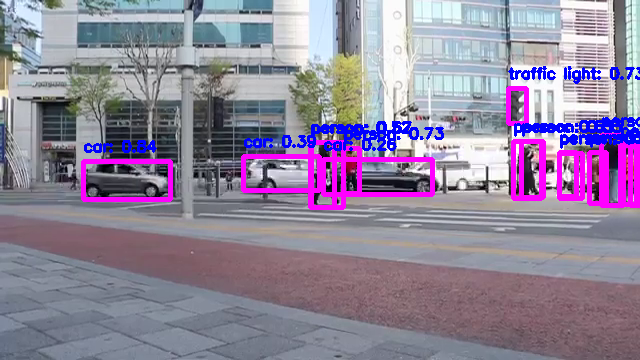

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from ultralytics import YOLO
import cv2
import math
from google.colab.patches import cv2_imshow
from pytube import YouTube

# Function to get the stream URL
def get_stream_url(youtube_url):
    yt = YouTube(youtube_url)
    stream = yt.streams.filter(progressive=True, file_extension='mp4').order_by('resolution').desc().first()
    return stream.url

# URL of the YouTube video
youtube_url = 'https://www.youtube.com/watch?v=3kO21UGpCNw'

# Get the direct video stream URL
video_url = get_stream_url(youtube_url)

# Open the video stream
cap = cv2.VideoCapture(video_url)

# Check if the video stream is opened successfully
if not cap.isOpened():
    print("Error: Could not open video stream.")
    exit()

# Model
model = YOLO("yolo-Weights/yolov8n.pt")  # Ensure the weights file is accessible in the Colab environment

# Object classes
classNames = ["person", "bicycle", "car", "motorbike", "aeroplane", "bus", "train", "truck", "boat",
              "traffic light", "fire hydrant", "stop sign", "parking meter", "bench", "bird", "cat",
              "dog", "horse", "sheep", "cow", "elephant", "bear", "zebra", "giraffe", "backpack", "umbrella",
              "handbag", "tie", "suitcase", "frisbee", "skis", "snowboard", "sports ball", "kite", "baseball bat",
              "baseball glove", "skateboard", "surfboard", "tennis racket", "bottle", "wine glass", "cup",
              "fork", "knife", "spoon", "bowl", "banana", "apple", "sandwich", "orange", "broccoli",
              "carrot", "hot dog", "pizza", "donut", "cake", "chair", "sofa", "pottedplant", "bed",
              "diningtable", "toilet", "tvmonitor", "laptop", "mouse", "remote", "keyboard", "cell phone",
              "microwave", "oven", "toaster", "sink", "refrigerator", "book", "clock", "vase", "scissors",
              "teddy bear", "hair drier", "toothbrush"]

# Get video properties
fps = cap.get(cv2.CAP_PROP_FPS)
frame_skip = int(fps)  # Number of frames to skip to process at 1-second intervals

# Output video file
output_path = "output_video.mp4"
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Codec
frame_size = (int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)), int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)))
out = cv2.VideoWriter(output_path, fourcc, fps, frame_size)

frame_count = 0

while cap.isOpened():
    success, img = cap.read()

    if not success:
        break

    # Skip frames
    if frame_count % frame_skip == 0:
        # Perform object detection
        results = model(img, stream=True)

        # Process the results
        for r in results:
            boxes = r.boxes

            for box in boxes:
                # Bounding box
                x1, y1, x2, y2 = box.xyxy[0]
                x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)  # Convert to int values

                # Draw bounding box
                cv2.rectangle(img, (x1, y1), (x2, y2), (255, 0, 255), 3)

                # Confidence
                confidence = math.ceil((box.conf[0] * 100)) / 100
                print("Confidence --->", confidence)

                # Class name
                cls = int(box.cls[0])
                print("Class name -->", classNames[cls])

                # Draw class name and confidence
                label = f"{classNames[cls]}: {confidence:.2f}"
                cv2.putText(img, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

        # Show the frame
        cv2_imshow(img)

        # Write the frame to the output video
        out.write(img)

    frame_count += 1

# Release resources
cap.release()
out.release()
cv2.destroyAllWindows()

# Download the video
from google.colab import files
files.download(output_path)